# Bel (Bilal) – Data Preparation

### Dependencies:

In [1]:
#Dependencies
import os
import requests
import pandas as pd
import numpy as np
import scipy.stats as stats
import pprint as pp
import matplotlib.pyplot as plt
import seaborn as sb


from config import tmdb_api_key

### IMDb Data Retrieval and Preparation

In [164]:
#Data sourced from https://www.imdb.com/interfaces/
inpath1 = os.path.join("Resources","IMDb","title.ratings.tsv")
inpath2 = os.path.join("Resources","IMDb","title.basics.tsv")
inpath3 = os.path.join("Resources","IMDb","title.akas.tsv")

ratings_df = pd.read_table(inpath1)
basics_df = pd.read_table(inpath2)
akas_df = pd.read_table(inpath3)

/Users/bilal/opt/anaconda3/envs/PythonData/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3186: DtypeWarning: Columns (4) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)
/Users/bilal/opt/anaconda3/envs/PythonData/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3186: DtypeWarning: Columns (7) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [165]:
ratings_df.head()

,tconst,averageRating,numVotes
0,tt0000001,5.7,1934
1,tt0000002,5.8,262
2,tt0000003,6.5,1759
3,tt0000004,5.6,177
4,tt0000005,6.2,2568


In [166]:
basics_df.head()

,tconst,titleType,primaryTitle,originalTitle,isAdult,startYear,endYear,runtimeMinutes,genres
0,tt0000001,short,Carmencita,Carmencita,0,1894,\N,1,"Documentary,Short"
1,tt0000002,short,Le clown et ses chiens,Le clown et ses chiens,0,1892,\N,5,"Animation,Short"
2,tt0000003,short,Pauvre Pierrot,Pauvre Pierrot,0,1892,\N,4,"Animation,Comedy,Romance"
3,tt0000004,short,Un bon bock,Un bon bock,0,1892,\N,12,"Animation,Short"
4,tt0000005,short,Blacksmith Scene,Blacksmith Scene,0,1893,\N,1,"Comedy,Short"


In [167]:
akas_df = akas_df.rename(columns={"titleId":"tconst"})

akas_df.head()

,tconst,ordering,title,region,language,types,attributes,isOriginalTitle
0,tt0000001,1,Карменсіта,UA,\N,imdbDisplay,\N,0
1,tt0000001,2,Carmencita,DE,\N,\N,literal title,0
2,tt0000001,3,Carmencita - spanyol tánc,HU,\N,imdbDisplay,\N,0
3,tt0000001,4,Καρμενσίτα,GR,\N,imdbDisplay,\N,0
4,tt0000001,5,Карменсита,RU,\N,imdbDisplay,\N,0


In [168]:
movie_df = pd.merge(ratings_df, basics_df, on = "tconst")

movie_df = pd.merge(movie_df, akas_df, on = "tconst")


In [169]:

movie_df = movie_df[["tconst","startYear", "averageRating", "numVotes", "language","title","primaryTitle","titleType","isAdult","genres","region"]]

#   Remove rows with empty column
movie_df = movie_df.loc[movie_df["language"]!="\\N"]

#   Remove rows with empty genre
movie_df = movie_df.loc[movie_df["genres"]!= "\\N"]

#   Remove rows with empty start year
movie_df = movie_df.loc[movie_df["startYear"]!="\\N"]
movie_df["startYear"] = movie_df["startYear"].astype(int)



recent_movies = movie_df.loc[movie_df["startYear"]>=2000]

#Reset Index
recent_movies = recent_movies.reset_index(drop = True)

recent_movies

,tconst,startYear,averageRating,numVotes,language,title,primaryTitle,titleType,isAdult,genres,region
0,tt0013274,2021,6.7,48,ru,История гражданской войны,Istoriya grazhdanskoy voyny,movie,0,Documentary,SUHH
1,tt0013274,2021,6.7,48,en,The History of the Civil War,Istoriya grazhdanskoy voyny,movie,0,Documentary,XWW
2,tt0035423,2001,6.4,85681,en,Kate & Leopold,Kate & Leopold,movie,0,"Comedy,Fantasy,Romance",ZA
3,tt0035423,2001,6.4,85681,bg,Кейт и Леополд,Kate & Leopold,movie,0,"Comedy,Fantasy,Romance",BG
4,tt0035423,2001,6.4,85681,ja,ニューヨークの恋人,Kate & Leopold,movie,0,"Comedy,Fantasy,Romance",JP
...,...,...,...,...,...,...,...,...,...,...,...
834213,tt9916766,2019,7.0,21,it,Episodio #10.15,Episode #10.15,tvEpisode,0,"Family,Game-Show,Reality-TV",IT
834214,tt9916766,2019,7.0,21,de,Folge #10.15,Episode #10.15,tvEpisode,0,"Family,Game-Show,Reality-TV",DE
834215,tt9916766,2019,7.0,21,pt,Episódio #10.15,Episode #10.15,tvEpisode,0,"Family,Game-Show,Reality-TV",PT
834216,tt9916766,2019,7.0,21,hi,एपिसोड #10.15,Episode #10.15,tvEpisode,0,"Family,Game-Show,Reality-TV",IN


In [170]:
#   Parse Genres column

# Store genres for each movie in list and delimit by comma
d1 = [x.split(",") for x in recent_movies["genres"]]

# Determine number of genre columns from max of list lengths
list_lens = [len(g) for g in d1]
highest_list = max(list_lens)
print(highest_list)

3


In [171]:
genre_dict = {}
init = True

for z in d1:

    if init == False:
        for x in range(0,highest_list):
            try:
                genre_dict[f"genre_{x+1}"].append(z[x])
            except:
                genre_dict[f"genre_{x+1}"].append("")
    else:
        for x in range(0,highest_list):
            try:
                genre_dict[f"genre_{x+1}"] = [z[x]]
            except Exception as e:
                genre_dict[f"genre_{x+1}"] = [""]

        init = False

parsed_genres = pd.DataFrame(genre_dict)

In [172]:
recent_movies = pd.merge(recent_movies,parsed_genres,right_index=True, left_index=True)
del recent_movies["genres"]


In [173]:
# Output
outpath = os.path.join("output","IMDb.csv")
recent_movies.to_csv(outpath)

In [174]:
#filter movies_df for English movies
movies_en = recent_movies.loc[recent_movies["language"]=="en"]


outpath = os.path.join("output","IMDB_en.csv")
movies_en.to_csv(outpath)



### TMDb Data Retrieval and Preparation

In [55]:
#   URL to search for movies released during or after 2000
url = "https://api.themoviedb.org/3/discover/movie"

#   Empty lists to store data for dataframe creation
adult = []
backdrop_path = []
genre_ids = []
id = []
original_language = []
original_title = []
overview = []
popularity = []
poster_path = []
release_date = []
title = []
video = []
vote_average = []
vote_count = []

# Page list to be iterated through
pages = np.arange(1,373,1)

#   Iterate through pages, scraping TMDb data for movie data
for page in pages:

    # Paramaters to be used
    filter_string = {
        "api_key":tmdb_api_key,
        "primary_release_date.gte":"2000",
        "with_watch_providers":"8|119|21",
        "watch_region":"AU",
        "sort_by":"primary_release_date.asc",
        "with_original_language":"en",
        "page":page

        }

    # Store response as json
    response = requests.get(url,params=filter_string).json()

    # Iterate through the response to pull each individual movie's data per page.
    for x in response["results"]:

        # Store results
        adult.append(x["adult"])
        backdrop_path.append(x["backdrop_path"])
        genre_ids.append(x["genre_ids"])
        id.append(x["id"])
        original_language.append(x["original_language"])
        original_title.append(x["original_title"])
        overview.append(x["overview"])
        popularity.append(x["popularity"])
        poster_path.append(x["poster_path"])
        release_date.append(x["release_date"])
        title.append(x["title"])
        video.append(x["video"])
        vote_average.append(x["vote_average"])
        vote_count.append(x["vote_count"])


In [56]:
#   Create DataFrame
movie_df_alpha = pd.DataFrame({"adult":adult,
"backdrop_path":backdrop_path, 
"genre_ids":genre_ids,
"tmdb_id":id,
"original_language":original_language,
"original_title":original_title,
"overview":overview,
"popularity":popularity,
"poster_path":poster_path,
"release_date":release_date,
"title":title,
"video":video,
"vote_average":vote_average,
"vote_count":vote_count})

#   Print Results
movie_df_alpha.tail()

,adult,backdrop_path,genre_ids,tmdb_id,original_language,original_title,overview,popularity,poster_path,release_date,title,video,vote_average,vote_count
7412,False,/1942UFAwkmAqqkQFcvMnld29825.jpg,[35],1054806,en,Chelsea Handler: Revolution,Chelsea Handler lets loose on her life choices...,6.412,/bL0bA4aZqml7BjTSRWH8uh2UvyC.jpg,2022-12-27,Chelsea Handler: Revolution,False,5.8,6
7413,False,/tWJpuxlBDoBnVyDM6dBh0NmuZ73.jpg,[35],1068114,en,Best of Stand-Up 2022,"From Bill Burr to Ali Wong, Gabriel Iglesias t...",6.983,/voxVt0OOD7OxLQApHhmc7IZ4co2.jpg,2022-12-31,Best of Stand-Up 2022,False,2.0,1
7414,False,/vHXMenEFXgfIkT8mxVT4nuR0Q8B.jpg,"[99, 80]",1066719,en,Mumbai Mafia: Police vs the Underworld,"In 1990s Mumbai, a crime boss and his network ...",46.215,/x8KYZWt1nraPdRSkNfxdrxFdjim.jpg,2023-01-06,Mumbai Mafia: Police vs the Underworld,False,6.3,6
7415,False,None,[99],1068727,en,Cats & Dogs,"In September 2022, Bengaluru made national new...",11.942,/j6tq3ybci8SGwX8BCmemrvPUtCC.jpg,2023-01-08,Cats & Dogs,False,0.0,0
7416,False,/f9PSbuMeBS5CuHEOVyymg5lcq8J.jpg,"[27, 28, 80, 53]",996727,en,The Price We Pay,"After a pawn shop robbery goes askew, two crim...",14.391,/1zjrFPZNGAJnJoqR7PxvsxRtsTt.jpg,2023-01-13,The Price We Pay,False,0.0,0


^The API's search url is helpful, but another url that searches per movie ID yields other variables including the IMDb ID;

https://api.themoviedb.org/3/discover/movie

- Can search with parameters such as streaming services and date of creation

- Lacks other data that the second URL has

https://api.themoviedb.org/3/movie/

- Response json contains more information, including IMDb ID and some revenue/budget data.

- Cannot search with parameters, only movie IDs

The first URL is used to pull data, namely the tmdb_id's which can then be iterated through with the second URL to get more results


In [57]:
#   Create List for TMDB IDs for iteration
mids = list(movie_df_alpha["tmdb_id"])

#   Define empty lists to store data 
adult = []
genre_ids = []
tmdb_id = []
imdb_id = []
budget = []
revenue = []
original_language = []
original_title = []
popularity = []
release_date = []
title = []
video = []
vote_average = []
vote_count = []
# production_companies = []

#Indicate beginning of search
print("Beginning Data Retrieval for movies on TMDb")
print("--------------------------------------------------")

for mid in mids:

    # Print currently searching id x for progress indication
    print(f"Searching for movie with id: {mid}")

    url = f"https://api.themoviedb.org/3/movie/{mid}?api_key={tmdb_api_key}"

    #General movie info

    response = requests.get(url).json()
    pp.pprint(response)
    
    try:
        title.append(response["title"])
    except Exception as e:
        print("error importing title")
        title.append(None)

    try:
        original_title.append(response["original_title"])
    except Exception as e:
        print("error importing original_title")
        original_title.append(None)

    try:
        original_language.append(response["original_language"])
    except Exception as e:
        print("error importing original_title")
        original_language.append(None)

    try:
        adult.append(response["adult"])
    except Exception as e:
        print("error importing adult")
        adult.append(None)

    try:
        lc = [z["name"] for z in response["genres"]]
        genre_ids.append(lc)
    except Exception as e:
        print("error importing genres")
        genre_ids.append(None)
        
    #Movie IDs

    try:
        tmdb_id.append(response["id"])
    except Exception as e:
        print("error importing tmdb_id")
        tmdb_id.append(None)

    try:
        imdb_id.append(response["imdb_id"])
    except Exception as e:
        print("error importing imdb_id")
        imdb_id.append(None)

    #Fiscal data

    try:
        budget.append(response["budget"])
    except Exception as e:
        print("error importing budget")
        budget.append(None)

    try:
        revenue.append(response["revenue"])
    except Exception as e:
        print("error importing revenue")
        revenue.append(None)


    #Popularity data

    try:
        vote_average.append(response["vote_average"])
    except Exception as e:
        print("error importing vote_average")
        vote_average.append(None)

    try:
        vote_count.append(response["vote_count"])
    except Exception as e:
        print("error importing vote_count")
        vote_count.append(None)

    try:
        popularity.append(response["popularity"])
    except Exception as e:
        print("error importing popularity")
        popularity.append(None)

    try:
        release_date.append(response["release_date"])
    except Exception as e:
        print("error importing release_date")
        release_date.append(None)

# Indicate search process has been complete:
print("--------------------------------------------------")
print("Data retrieval complete")


Beginning Data Retrieval for movies on TMDb
--------------------------------------------------
Searching for movie with id: 1011182
{'adult': False,
 'backdrop_path': None,
 'belongs_to_collection': None,
 'budget': 0,
 'genres': [{'id': 99, 'name': 'Documentary'}],
 'homepage': '',
 'id': 1011182,
 'imdb_id': 'tt2032414',
 'original_language': 'en',
 'original_title': 'Close Encounters: Proof of Alien Contact',
 'overview': 'This documentary examines whether UFOs are real. It examines '
             'over 250 amateur video clips, evaluates several recent '
             'revelations about Roswell, and examines footage of the removal '
             'of an alien implant.',
 'popularity': 0.6,
 'poster_path': '/pZF2CqHfdC59DB6p6GodEknhOhl.jpg',
 'production_companies': [],
 'production_countries': [],
 'release_date': '2000-01-01',
 'revenue': 0,
 'runtime': 50,
 'spoken_languages': [],
 'status': 'Released',
 'tagline': '',
 'title': 'Close Encounters: Proof of Alien Contact',
 'video': 

In [58]:
#Create DataFrame
movie_df = pd.DataFrame({"adult":adult,
                "genre_id":genre_ids,
                "tmdb_id":tmdb_id,
                "imdb_id" :imdb_id,
                "budget":budget,
                "revenue":revenue, 
                "original_title" : original_title,
                "original_language":original_language,
                "popularity":popularity, 
                "release_date":release_date,
                "title":title,
                "vote_average":vote_average,
                "vote_count":vote_count})



In [60]:
#Clean DataFrame by dropping empty values
movie_df = movie_df.dropna(how="any")

movie_df


,adult,genre_id,tmdb_id,imdb_id,budget,revenue,original_title,original_language,popularity,release_date,title,vote_average,vote_count
0,False,[Documentary],1011182,tt2032414,0,0,Close Encounters: Proof of Alien Contact,en,0.600,2000-01-01,Close Encounters: Proof of Alien Contact,5.000,1
1,False,[],923893,tt12179456,0,0,Brad Pitt & Jennifer Aniston: Hollywood's Coup...,en,0.655,2000-01-01,Brad Pitt & Jennifer Aniston: Hollywood's Coup...,0.000,0
2,False,[],245955,tt1795669,0,0,The Amish: A People of Preservation,en,0.600,2000-01-01,The Amish: A People of Preservation,0.000,0
3,False,"[Drama, Family]",134803,tt0221431,0,0,The Newcomers,en,2.339,2000-01-01,The Newcomers,3.900,9
4,False,"[Drama, Science Fiction, Thriller]",65397,tt0249840,0,0,Nightfall,en,1.555,2000-01-01,Nightfall,3.200,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
7411,False,[Comedy],1054809,tt23848684,0,0,Vir Das: Landing,en,5.112,2022-12-26,Vir Das: Landing,5.000,2
7412,False,[Comedy],1054806,tt23711530,0,0,Chelsea Handler: Revolution,en,6.412,2022-12-27,Chelsea Handler: Revolution,5.800,6
7413,False,[Comedy],1068114,tt25396646,0,0,Best of Stand-Up 2022,en,6.983,2022-12-31,Best of Stand-Up 2022,2.000,1
7414,False,"[Documentary, Crime]",1066719,tt24224996,0,0,Mumbai Mafia: Police vs the Underworld,en,46.215,2023-01-06,Mumbai Mafia: Police vs the Underworld,6.333,6


Parsing the Genre ID column:

In [64]:
#   Parse Genres column

# Store genres for each movie in list and delimit by comma
d1 = movie_df["genre_id"]

# Determine number of genre columns from max of list lengths
list_lens = [len(g) for g in d1]
highest_list = max(list_lens)
print(f"Movie with the highest number of genres has {highest_list} movies")

Movie with the highest number of genres has 6 movies


In [65]:
#   Create Dictionary to store List
genre_dict = {}

#   Initializer
init = True

#Iterate through the list of lists to extract individual genres.
for z in movie_df["genre_id"]:

    if init == False:
        for x in range(0,highest_list):
            try:
                genre_dict[f"genre_{x+1}"].append(z[x])
            except:
                genre_dict[f"genre_{x+1}"].append("")
    else:
        for x in range(0,highest_list):
            try:
                genre_dict[f"genre_{x+1}"] = [z[x]]
            except Exception as e:
                genre_dict[f"genre_{x+1}"] = [""]

        init = False

#Create dataframe with the dictionary of lists
parsed_genres = pd.DataFrame(genre_dict)

#print result
parsed_genres

,genre_1,genre_2,genre_3,genre_4,genre_5,genre_6
0,Documentary,,,,,
1,,,,,,
2,,,,,,
3,Drama,Family,,,,
4,Drama,Science Fiction,Thriller,,,
...,...,...,...,...,...,...
7059,Comedy,,,,,
7060,Comedy,,,,,
7061,Comedy,,,,,
7062,Documentary,Crime,,,,


In [66]:
#   merge with main df

parsed_df = pd.merge(movie_df, parsed_genres, right_index = True, left_index = True)

#Print
parsed_df.head()

,adult,genre_id,tmdb_id,imdb_id,budget,revenue,original_title,original_language,popularity,release_date,title,vote_average,vote_count,genre_1,genre_2,genre_3,genre_4,genre_5,genre_6
0,False,[Documentary],1011182,tt2032414,0,0,Close Encounters: Proof of Alien Contact,en,0.600,2000-01-01,Close Encounters: Proof of Alien Contact,5.0,1,Documentary,,,,,
1,False,[],923893,tt12179456,0,0,Brad Pitt & Jennifer Aniston: Hollywood's Coup...,en,0.655,2000-01-01,Brad Pitt & Jennifer Aniston: Hollywood's Coup...,0.0,0,,,,,,
2,False,[],245955,tt1795669,0,0,The Amish: A People of Preservation,en,0.600,2000-01-01,The Amish: A People of Preservation,0.0,0,,,,,,
3,False,"[Drama, Family]",134803,tt0221431,0,0,The Newcomers,en,2.339,2000-01-01,The Newcomers,3.9,9,Drama,Family,,,,
4,False,"[Drama, Science Fiction, Thriller]",65397,tt0249840,0,0,Nightfall,en,1.555,2000-01-01,Nightfall,3.2,4,Drama,Science Fiction,Thriller,,,


In [92]:
#   Combine the genre columns into a single column for plotting.
g1_df = parsed_df[["tmdb_id","genre_1"]]
g1_df = g1_df.rename(columns = {"genre_1":"genre"})

g2_df = parsed_df[["tmdb_id","genre_2"]].loc[parsed_df[["tmdb_id","genre_2"]]["genre_2"]!=""]
g2_df = g2_df.rename(columns={"genre_2":"genre"})

g3_df = parsed_df[["tmdb_id","genre_3"]].loc[parsed_df[["tmdb_id","genre_3"]]["genre_3"]!=""]
g3_df = g3_df.rename(columns= {"genre_3":"genre"})

g4_df = parsed_df[["tmdb_id","genre_4"]].loc[parsed_df[["tmdb_id","genre_4"]]["genre_4"]!=""]
g4_df = g4_df.rename(columns = {"genre_4":"genre"})

g5_df = parsed_df[["tmdb_id","genre_5"]].loc[parsed_df[["tmdb_id","genre_5"]]["genre_5"]!=""]
g5_df = g5_df.rename(columns={"genre_5":"genre"})

g6_df = parsed_df[["tmdb_id","genre_6"]].loc[parsed_df[["tmdb_id","genre_6"]]["genre_6"]!=""]
g6_df = g6_df.rename(columns= {"genre_6":"genre"})

combined_genres = g1_df.append(g2_df).append(g3_df).append(g4_df).append(g5_df).append(g6_df)

combined_genres

,tmdb_id,genre
0,1011182,Documentary
1,923893,
2,245955,
3,134803,Drama
4,65397,Drama
...,...,...
3281,153518,Science Fiction
3360,422551,Music
4474,513536,Science Fiction
6312,770893,Family


In [78]:
parsed_df_with_combined = pd.merge(parsed_df,combined_genres, on = "tmdb_id")
parsed_df.head(3)

,adult,genre_id,tmdb_id,imdb_id,budget,revenue,original_title,original_language,popularity,release_date,title,vote_average,vote_count,genre_1,genre_2,genre_3,genre_4,genre_5,genre_6
0,False,[Documentary],1011182,tt2032414,0,0,Close Encounters: Proof of Alien Contact,en,0.600,2000-01-01,Close Encounters: Proof of Alien Contact,5.0,1,Documentary,,,,,
1,False,[],923893,tt12179456,0,0,Brad Pitt & Jennifer Aniston: Hollywood's Coup...,en,0.655,2000-01-01,Brad Pitt & Jennifer Aniston: Hollywood's Coup...,0.0,0,,,,,,
2,False,[],245955,tt1795669,0,0,The Amish: A People of Preservation,en,0.600,2000-01-01,The Amish: A People of Preservation,0.0,0,,,,,,


In [77]:
parsed_df_with_combined.head(3)

,adult,genre_id,tmdb_id,imdb_id,budget,revenue,original_title,original_language,popularity,release_date,title,vote_average,vote_count,genre_1,genre_2,genre_3,genre_4,genre_5,genre_6,genre
0,False,[Documentary],1011182,tt2032414,0,0,Close Encounters: Proof of Alien Contact,en,0.600,2000-01-01,Close Encounters: Proof of Alien Contact,5.0,1,Documentary,,,,,,Documentary
1,False,[],923893,tt12179456,0,0,Brad Pitt & Jennifer Aniston: Hollywood's Coup...,en,0.655,2000-01-01,Brad Pitt & Jennifer Aniston: Hollywood's Coup...,0.0,0,,,,,,,
2,False,[],245955,tt1795669,0,0,The Amish: A People of Preservation,en,0.600,2000-01-01,The Amish: A People of Preservation,0.0,0,,,,,,,


In [ ]:
#   Output to csv

m_outpath = os.path.join("output","tmdb_data_parsed.csv")
parsed_df.to_csv(m_outpath)

m_outpath = os.path.join("output","tmdb_genre_data.csv")
parsed_df_with_combined.to_csv(m_outpath)


In [16]:
# pre_merge = parsed_df[['adult', 'tmdb_id', 'imdb_id', 'budget', 'revenue',
#        'original_title', 'original_language', 'popularity', 'release_date',
#        'title', 'vote_average', 'vote_count']]

6092

### Data Preparation and Merging (IMDb and TMDb)

In [8]:
#   Read in genre csv
inpath = os.path.join("output","tmdb_genre_data.csv")
movie_df = pd.read_csv(inpath)

#   Printdf
movie_df.head()

,Unnamed: 0,adult,genre_id,tmdb_id,imdb_id,budget,revenue,original_title,original_language,popularity,...,title,vote_average,vote_count,genre_1,genre_2,genre_3,genre_4,genre_5,genre_6,genre
0,0,False,['Documentary'],1011182,tt2032414,0,0,Close Encounters: Proof of Alien Contact,en,0.600,...,Close Encounters: Proof of Alien Contact,5.0,1,Documentary,NaN,NaN,NaN,NaN,NaN,Documentary
1,1,False,[],923893,tt12179456,0,0,Brad Pitt & Jennifer Aniston: Hollywood's Coup...,en,0.655,...,Brad Pitt & Jennifer Aniston: Hollywood's Coup...,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,False,[],245955,tt1795669,0,0,The Amish: A People of Preservation,en,0.600,...,The Amish: A People of Preservation,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,False,"['Drama', 'Family']",134803,tt0221431,0,0,The Newcomers,en,2.339,...,The Newcomers,3.9,9,Drama,Family,NaN,NaN,NaN,NaN,Drama
4,4,False,"['Drama', 'Family']",134803,tt0221431,0,0,The Newcomers,en,2.339,...,The Newcomers,3.9,9,Drama,Family,NaN,NaN,NaN,NaN,Family


In [9]:
#   Clean data by deleting other genre columns
del movie_df["genre_id"]
del movie_df["genre_1"]
del movie_df["genre_2"]
del movie_df["genre_3"]
del movie_df["genre_4"]
del movie_df["genre_5"]
del movie_df["genre_6"]

#   Delete Unnamed column
del movie_df["Unnamed: 0"]

In [10]:
#   Check column value count
movie_df.count()

adult                13373
tmdb_id              13373
imdb_id              13280
budget               13373
revenue              13373
original_title       13373
original_language    13373
popularity           13373
release_date         13373
title                13373
vote_average         13373
vote_count           13373
genre                13093
dtype: int64

- This data will be merged with the imdb dataset, so empty values in the imdb_id column will be dropped

In [11]:
# Drop na
movie_df = movie_df[movie_df["imdb_id"].notna()]

movie_df.count()

adult                13280
tmdb_id              13280
imdb_id              13280
budget               13280
revenue              13280
original_title       13280
original_language    13280
popularity           13280
release_date         13280
title                13280
vote_average         13280
vote_count           13280
genre                13001
dtype: int64

In [12]:
movie_df.head()

,adult,tmdb_id,imdb_id,budget,revenue,original_title,original_language,popularity,release_date,title,vote_average,vote_count,genre
0,False,1011182,tt2032414,0,0,Close Encounters: Proof of Alien Contact,en,0.600,2000-01-01,Close Encounters: Proof of Alien Contact,5.0,1,Documentary
1,False,923893,tt12179456,0,0,Brad Pitt & Jennifer Aniston: Hollywood's Coup...,en,0.655,2000-01-01,Brad Pitt & Jennifer Aniston: Hollywood's Coup...,0.0,0,NaN
2,False,245955,tt1795669,0,0,The Amish: A People of Preservation,en,0.600,2000-01-01,The Amish: A People of Preservation,0.0,0,NaN
3,False,134803,tt0221431,0,0,The Newcomers,en,2.339,2000-01-01,The Newcomers,3.9,9,Drama
4,False,134803,tt0221431,0,0,The Newcomers,en,2.339,2000-01-01,The Newcomers,3.9,9,Family


In [13]:
#   Read in IMDb english csv    (This dataset was prepared in the imdb.ipynb notebook)
inpath = os.path.join("output","IMDB_en.csv")

imdb_df = pd.read_csv(inpath)

#   Remove duplicates of ids 
imdb_df = imdb_df.drop_duplicates(subset = "tconst")

#   Rename tconst id column for merging
imdb_df = imdb_df.rename(columns= {"tconst":"imdb_id"})

imdb_df.head()

,Unnamed: 0,imdb_id,startYear,averageRating,numVotes,language,title,primaryTitle,titleType,isAdult,region,genre_1,genre_2,genre_3
0,1,tt0013274,2021,6.7,48,en,The History of the Civil War,Istoriya grazhdanskoy voyny,movie,0,XWW,Documentary,NaN,NaN
1,2,tt0035423,2001,6.4,85681,en,Kate & Leopold,Kate & Leopold,movie,0,ZA,Comedy,Fantasy,Romance
5,11,tt0062336,2020,6.4,163,en,The Tango of the Widower and Its Distorting Mi...,The Tango of the Widower and Its Distorting Mi...,movie,0,XWW,Drama,NaN,NaN
6,15,tt0067626,2006,5.7,130,en,Before the Rally,Before the Rally,short,0,XWW,Documentary,Short,NaN
7,16,tt0067683,2006,6.4,92,en,Workers '71: Nothing About Us Without Us,Workers '71: Nothing About Us Without Us,movie,0,XWW,Documentary,NaN,NaN


In [14]:
# Combine parsed genre columns
g1_df = imdb_df[["imdb_id","genre_1"]]
g1_df = g1_df.rename(columns = {"genre_1":"genre"})

g2_df = imdb_df[["imdb_id","genre_2"]].loc[imdb_df[["imdb_id","genre_2"]]["genre_2"]!=""]
g2_df = g2_df.rename(columns={"genre_2":"genre"})

g3_df = imdb_df[["imdb_id","genre_3"]].loc[imdb_df[["imdb_id","genre_3"]]["genre_3"]!=""]
g3_df = g3_df.rename(columns= {"genre_3":"genre"})

imdb_combined_genres = g1_df.append(g2_df).append(g3_df)

imdb_combined_genres

,imdb_id,genre
0,tt0013274,Documentary
1,tt0035423,Comedy
5,tt0062336,Drama
6,tt0067626,Documentary
7,tt0067683,Documentary
...,...,...
240220,tt9916170,NaN
240221,tt9916206,NaN
240222,tt9916216,NaN
240224,tt9916362,NaN


In [15]:
imdb_df = pd.merge(imdb_df,imdb_combined_genres, on = "imdb_id")

# Keep columns of interest
imdb_df = imdb_df[["imdb_id","startYear","averageRating","numVotes","genre"]]

imdb_df

,imdb_id,startYear,averageRating,numVotes,genre
0,tt0013274,2021,6.7,48,Documentary
1,tt0013274,2021,6.7,48,NaN
2,tt0013274,2021,6.7,48,NaN
3,tt0035423,2001,6.4,85681,Comedy
4,tt0035423,2001,6.4,85681,Fantasy
...,...,...,...,...,...
331771,tt9916362,2020,6.4,5101,History
331772,tt9916362,2020,6.4,5101,NaN
331773,tt9916428,2019,3.8,14,Adventure
331774,tt9916428,2019,3.8,14,History


In [16]:
# Merge
merged = pd.merge(movie_df,imdb_df, on = "imdb_id")

#Remove duplicate genres
merged = merged.drop_duplicates(subset = ["imdb_id","genre_x","genre_y"])

# Print
merged.head()

,adult,tmdb_id,imdb_id,budget,revenue,original_title,original_language,popularity,release_date,title,vote_average,vote_count,genre_x,startYear,averageRating,numVotes,genre_y
0,False,134803,tt0221431,0,0,The Newcomers,en,2.339,2000-01-01,The Newcomers,3.9,9,Drama,2000,4.8,465,Drama
1,False,134803,tt0221431,0,0,The Newcomers,en,2.339,2000-01-01,The Newcomers,3.9,9,Drama,2000,4.8,465,Family
2,False,134803,tt0221431,0,0,The Newcomers,en,2.339,2000-01-01,The Newcomers,3.9,9,Drama,2000,4.8,465,NaN
3,False,134803,tt0221431,0,0,The Newcomers,en,2.339,2000-01-01,The Newcomers,3.9,9,Family,2000,4.8,465,Drama
4,False,134803,tt0221431,0,0,The Newcomers,en,2.339,2000-01-01,The Newcomers,3.9,9,Family,2000,4.8,465,Family


In [17]:
#   Check if imdb data has some genre data that can replace tmdb null values
merged.loc[merged["genre_x"].isna()]

,adult,tmdb_id,imdb_id,budget,revenue,original_title,original_language,popularity,release_date,title,vote_average,vote_count,genre_x,startYear,averageRating,numVotes,genre_y
612,False,1995,tt0146316,115000000,274703340,Lara Croft: Tomb Raider,en,31.591,2001-06-11,Lara Croft: Tomb Raider,5.865,5438,NaN,2001,5.7,211175,Action
613,False,1995,tt0146316,115000000,274703340,Lara Croft: Tomb Raider,en,31.591,2001-06-11,Lara Croft: Tomb Raider,5.865,5438,NaN,2001,5.7,211175,Adventure
614,False,1995,tt0146316,115000000,274703340,Lara Croft: Tomb Raider,en,31.591,2001-06-11,Lara Croft: Tomb Raider,5.865,5438,NaN,2001,5.7,211175,Fantasy
831,False,36586,tt0187738,54000000,155010032,Blade II,en,42.245,2002-03-22,Blade II,6.504,4063,NaN,2002,6.7,221584,Action
832,False,36586,tt0187738,54000000,155010032,Blade II,en,42.245,2002-03-22,Blade II,6.504,4063,NaN,2002,6.7,221584,Horror
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21406,False,861604,tt15095938,0,0,Blood Brothers: Malcolm X & Muhammad Ali,en,8.611,2021-09-09,Blood Brothers: Malcolm X & Muhammad Ali,7.300,25,NaN,2021,6.9,1027,Documentary
21407,False,861604,tt15095938,0,0,Blood Brothers: Malcolm X & Muhammad Ali,en,8.611,2021-09-09,Blood Brothers: Malcolm X & Muhammad Ali,7.300,25,NaN,2021,6.9,1027,History
21711,False,882506,tt15000128,0,0,Good Boys for Life,en,0.979,2021-10-08,Good Boys for Life,0.000,0,NaN,2021,4.4,49,Comedy
21712,False,882506,tt15000128,0,0,Good Boys for Life,en,0.979,2021-10-08,Good Boys for Life,0.000,0,NaN,2021,4.4,49,Drama


In [18]:
#      Update df to include as little nan genres as possible
imdb_genres = merged[['adult', 'tmdb_id', 'imdb_id', 'budget', 'revenue', 'original_title',
       'original_language', 'popularity', 'release_date', 'title',
       'vote_average', 'vote_count', 'genre_y', 'startYear', 'averageRating',
       'numVotes']]

imdb_genres = imdb_genres.rename(columns = {"genre_y":"genre"})

tmdb_genres = merged[['adult', 'tmdb_id', 'imdb_id', 'budget', 'revenue', 'original_title',
       'original_language', 'popularity', 'release_date', 'title',
       'vote_average', 'vote_count', 'genre_x', 'startYear', 'averageRating',
       'numVotes']]

tmdb_genres = tmdb_genres.rename(columns = {"genre_x":"genre"})

tmdb_genres.update(imdb_genres, overwrite = False)

merged= tmdb_genres

In [19]:
#   Drop empty values
merged_cleaned =merged.dropna(subset = ["genre"])
merged_cleaned = merged_cleaned.rename( columns = {"vote_average":"tmdb_vote_average",
                                "vote_count":"tmdb_vote_count",
                                "averageRating":"imdb_vote_average",
                                "numVotes":"imdb_vote_count"})

#   Drop Duplicates
merged_cleaned = merged_cleaned.drop_duplicates(subset = ["imdb_id","genre"])

In [20]:
#   Print
merged_cleaned.count()

adult                7682
tmdb_id              7682
imdb_id              7682
budget               7682
revenue              7682
original_title       7682
original_language    7682
popularity           7682
release_date         7682
title                7682
tmdb_vote_average    7682
tmdb_vote_count      7682
genre                7682
startYear            7682
imdb_vote_average    7682
imdb_vote_count      7682
dtype: int64

In [21]:
#   Export final csv 
outpath = os.path.join("output","final.csv")

merged_cleaned.to_csv(outpath)

### Optional Data Exploration

#### Before filtering for top 10 genres

In [106]:
#   Read in prepared csv

#   Data created by Johnny
inpath = os.path.join("output","J_final.csv")


inpath2 = os.path.join("output","final.csv")

movies = pd.read_csv(inpath)
genres = pd.read_csv(inpath2)

# Delete columns of disinterest
del genres["Unnamed: 0"]
del genres["original_title"]
del genres["title"]
del genres["popularity"]
del genres["adult"]


In [107]:
genres.head()

,tmdb_id,imdb_id,budget,revenue,original_language,release_date,tmdb_vote_average,tmdb_vote_count,genre,startYear,imdb_vote_average,imdb_vote_count
0,134803,tt0221431,0,0,en,2000-01-01,3.900,9,Drama,2000,4.8,465
1,134803,tt0221431,0,0,en,2000-01-01,3.900,9,Family,2000,4.8,465
2,44388,tt0139388,0,0,en,2000-01-01,6.206,17,Comedy,2000,5.6,2264
3,44388,tt0139388,0,0,en,2000-01-01,6.206,17,Romance,2000,5.6,2264
4,10384,tt0134983,90000000,14828081,en,2000-01-14,4.954,312,Science Fiction,2000,4.8,18327


In [108]:
#   Print
movies = movies[['tmdb_id', 'imdb_id', 'original_language', 'original_title',
       'release_date', 'tmdb_rating_avg',
       'tmdb_vote_count','imdb_rating', 'imdb_votes', 'budget', 'revenue']]

movies.head()

,tmdb_id,imdb_id,original_language,original_title,release_date,tmdb_rating_avg,tmdb_vote_count,imdb_rating,imdb_votes,budget,revenue
0,134803,tt0221431,en,The Newcomers,1/01/2000,3.9,9,4.8,465,0,0
1,65397,tt0249840,en,Nightfall,1/01/2000,3.3,4,3.3,463,0,0
2,44388,tt0139388,en,It Had to Be You,1/01/2000,6.2,17,5.6,2265,0,0
3,10384,tt0134983,en,Supernova,14/01/2000,5.0,312,4.8,18336,90000000,14828081
4,77434,tt0197096,en,What's Cooking?,20/01/2000,5.7,19,6.8,2811,0,0


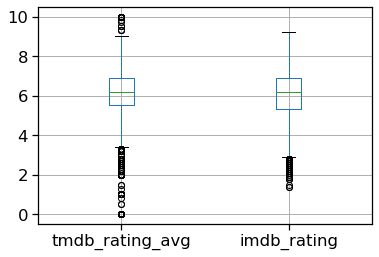

In [109]:
rating_boxplot = movies.boxplot(column = ["tmdb_rating_avg","imdb_rating"])


(0, 10000)

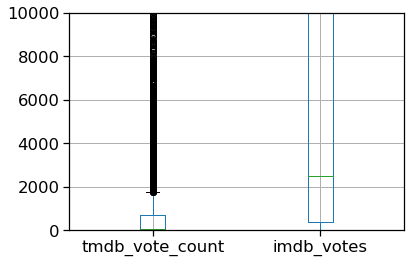

In [110]:
vc_boxplot = movies.boxplot( column = ["tmdb_vote_count","imdb_votes"])

vc_boxplot.set_ylim(0,10000)

In [111]:
tmdb_1q = movies["tmdb_vote_count"].quantile(0.25)
tmdb_3q = movies["tmdb_vote_count"].quantile(0.75)
print(f"TMDb First Quartile: {tmdb_1q}")
print(f"TMDb Third Quartile: {tmdb_3q}")

imdb_1q = movies["imdb_votes"].quantile(0.25)
imdb_3q = movies["imdb_votes"].quantile(0.75)
print(f"IMDb First Quartile: {imdb_1q}")
print(f"TMDb Third Quartile: {imdb_3q}")

TMDb First Quartile: 8.0
TMDb Third Quartile: 706.0
IMDb First Quartile: 386.0
TMDb Third Quartile: 31884.0


In [112]:
# movies.loc[movies["tmdb_rating_avg"]==0]
# movies.loc[movies["tmdb_rating_avg"]==10]

#Remove movies with less than 2 reviews
movies.loc[movies["tmdb_vote_count"]>=1]


,tmdb_id,imdb_id,original_language,original_title,release_date,tmdb_rating_avg,tmdb_vote_count,imdb_rating,imdb_votes,budget,revenue
0,134803,tt0221431,en,The Newcomers,1/01/2000,3.9,9,4.8,465,0,0
1,65397,tt0249840,en,Nightfall,1/01/2000,3.3,4,3.3,463,0,0
2,44388,tt0139388,en,It Had to Be You,1/01/2000,6.2,17,5.6,2265,0,0
3,10384,tt0134983,en,Supernova,14/01/2000,5.0,312,4.8,18336,90000000,14828081
4,77434,tt0197096,en,What's Cooking?,20/01/2000,5.7,19,6.8,2811,0,0
...,...,...,...,...,...,...,...,...,...,...,...
5348,575322,tt5656994,en,Звёздный разум,6/01/2022,5.6,196,3.4,3040,0,0
5349,825808,tt11209212,en,See for Me,7/01/2022,6.2,132,5.8,5113,0,0
5350,916740,tt13978306,en,Brazen,13/01/2022,4.9,310,4.1,12594,0,0
5351,760926,tt6020800,en,Gold,13/01/2022,6.3,431,5.4,10031,6500000,176048


- Removed 200 movies

In [113]:
# Apply filter to genre
genres = genres.loc[genres["tmdb_vote_count"]>1]
movies = movies.loc[movies["tmdb_vote_count"]>1]

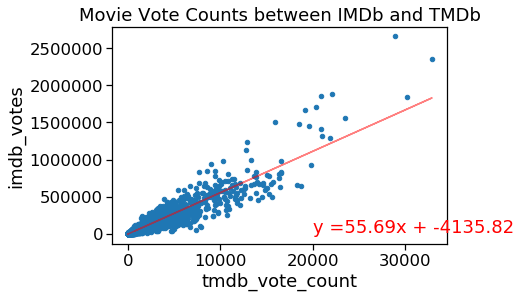

Regression P-value: 0.0
Regression R: 0.9371074462556053


In [114]:
vc_plot = movies.plot(kind = "scatter", x = "tmdb_vote_count", y = "imdb_votes")
vc_plot.set_title("Movie Vote Counts between IMDb and TMDb")

x = movies["tmdb_vote_count"]
y = movies["imdb_votes"]
m_slope, m_int, m_r, m_p, m_stderr = stats.linregress(x = x,y = y)

regression = m_slope*x + m_int

plt.annotate(f"y ={round(m_slope,2)}x + {round(m_int,2)}", xy = (20000,25000), color = "r")

plt.plot(x,regression, color = "r", alpha = 0.5)
plt.show()

print(f"Regression P-value: {m_p}")
print(f"Regression R: {m_r}")

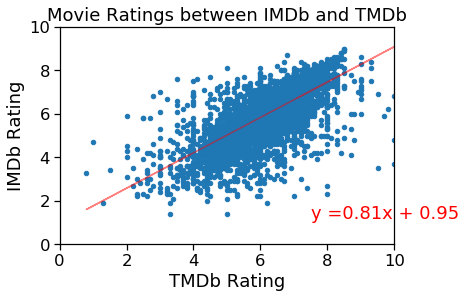

Regression P-value: 0.0
Regression R: 0.7084990161983994


In [115]:
v1_plot = movies.plot(kind = "scatter", x = "tmdb_rating_avg", y = "imdb_rating")
v1_plot.set_title("Movie Ratings between IMDb and TMDb")
v1_plot.set_xlabel("TMDb Rating")
v1_plot.set_ylabel("IMDb Rating")
v1_plot.set_xlim(0,10)
v1_plot.set_ylim(0,10)

x = movies["tmdb_rating_avg"]
y = movies["imdb_rating"]
m_slope, m_int, m_r, m_p, m_stderr = stats.linregress(x = x,y = y)

regression = m_slope*x + m_int

plt.annotate(f"y ={round(m_slope,2)}x + {round(m_int,2)}", xy = (7.5,1.2), color = "r")

plt.plot(x,regression, color = "r", alpha = 0.5)
plt.show()

print(f"Regression P-value: {m_p}")
print(f"Regression R: {m_r}")

In [116]:
genres.groupby("genre").median().sort_values(by = "imdb_vote_average", ascending = False)

,tmdb_id,budget,revenue,tmdb_vote_average,tmdb_vote_count,startYear,imdb_vote_average,imdb_vote_count
genre,,,,,,,,
Sport,70.0,30000000.0,216763646.0,7.9620,8380.0,2004.0,8.10,689617.0
Short,181504.0,0.0,0.0,6.3000,5.0,2004.0,6.90,99.0
Biography,404851.5,12000000.0,9347536.0,6.7345,667.5,2017.0,6.90,46373.5
War,266790.0,11500000.0,510839.0,6.3760,707.0,2014.5,6.40,40164.0
Action,218988.5,3250000.0,154985.0,6.2870,487.0,2014.0,6.20,22888.5
Crime,265208.0,0.0,0.0,6.3370,429.0,2015.0,6.20,17939.0
Documentary,415312.0,0.0,0.0,6.3180,243.0,2017.0,6.20,8722.0
Drama,322240.0,0.0,0.0,6.3000,379.0,2015.0,6.20,17381.0
Family,227004.5,1800000.0,351792.0,6.3095,445.0,2014.0,6.20,22304.0


In [117]:
#Check how many movies there are in each category
genres.groupby("genre").count().sort_values(by = "imdb_vote_average", ascending = True)

,tmdb_id,imdb_id,budget,revenue,original_language,release_date,tmdb_vote_average,tmdb_vote_count,startYear,imdb_vote_average,imdb_vote_count
genre,,,,,,,,,,,
Sport,1,1,1,1,1,1,1,1,1,1,1
Short,1,1,1,1,1,1,1,1,1,1,1
Biography,6,6,6,6,6,6,6,6,6,6,6
Sci-Fi,14,14,14,14,14,14,14,14,14,14,14
Western,28,28,28,28,28,28,28,28,28,28,28
War,54,54,54,54,54,54,54,54,54,54,54
History,106,106,106,106,106,106,106,106,106,106,106
Music,160,160,160,160,160,160,160,160,160,160,160
Fantasy,197,197,197,197,197,197,197,197,197,197,197


* Removing genres sport, short, biography, sci-fi, western, war, history, and music

In [118]:
#Remove above genres
filter = [x not in ["Sport","Short","Biography","Sci-Fi","Western","War","History","Music"] for x in genres["genre"]]
genres = genres.loc[filter]


In [119]:
#   Take top 5 imdb ratings by genres  (mean)
meang = list(genres.groupby("genre").mean().sort_values(by = "imdb_vote_average", ascending = False).index)[0:7]
meang

['Mystery', 'Drama', 'Crime', 'Action', 'Adventure', 'Family', 'Thriller']

In [120]:
#   Take top 10 imdb ratings by genres  (median)
medg = list(genres.groupby("genre").median().sort_values(by = "imdb_vote_average", ascending = False).index[0:7])
medg

['Action', 'Adventure', 'Crime', 'Documentary', 'Drama', 'Family', 'Fantasy']

In [121]:
#Check if mean and median lists of top genres are similar/identical
print([x in medg for x in meang])
print([x in meang for x in medg])

[False, True, True, True, True, True, False]
[True, True, True, False, True, True, False]


* Both have only 2 differing top genres

Using mean top 7

In [122]:
#   Filter out for top 10
filter = [x in meang for x in genres["genre"]]

genres = genres.loc[filter]
genres

,tmdb_id,imdb_id,budget,revenue,original_language,release_date,tmdb_vote_average,tmdb_vote_count,genre,startYear,imdb_vote_average,imdb_vote_count
0,134803,tt0221431,0,0,en,2000-01-01,3.900,9,Drama,2000,4.8,465
1,134803,tt0221431,0,0,en,2000-01-01,3.900,9,Family,2000,4.8,465
7,10384,tt0134983,90000000,14828081,en,2000-01-14,4.954,312,Thriller,2000,4.8,18327
9,77434,tt0197096,0,0,en,2000-01-20,5.684,19,Drama,2000,6.8,2811
10,2360,tt0195234,10000000,26330482,en,2000-01-24,6.504,358,Crime,2000,6.9,18715
...,...,...,...,...,...,...,...,...,...,...,...,...
7671,575322,tt5656994,0,0,en,2022-01-06,5.600,196,Action,2022,3.4,3033
7677,926899,tt11703050,0,0,en,2022-01-14,7.100,790,Crime,2022,6.8,17442
7679,941948,tt16418578,0,0,en,2022-01-15,4.500,2,Action,2022,4.3,76
7680,941948,tt16418578,0,0,en,2022-01-15,4.500,2,Crime,2022,4.3,76


In [123]:
#   Filter out for top 10 using imdb id of genres df

#List of imdb ids of movies in the top 10 genres
topg = list(genres["imdb_id"])

#Filter for said movies
filter = [x in topg for x in movies["imdb_id"]]
movies = movies.loc[filter]

movies

,tmdb_id,imdb_id,original_language,original_title,release_date,tmdb_rating_avg,tmdb_vote_count,imdb_rating,imdb_votes,budget,revenue
0,134803,tt0221431,en,The Newcomers,1/01/2000,3.9,9,4.8,465,0,0
3,10384,tt0134983,en,Supernova,14/01/2000,5.0,312,4.8,18336,90000000,14828081
4,77434,tt0197096,en,What's Cooking?,20/01/2000,5.7,19,6.8,2811,0,0
6,2360,tt0195234,en,Saving Grace,24/01/2000,6.5,358,6.9,18719,10000000,26330482
8,4234,tt0134084,en,Scream 3,3/02/2000,6.0,2746,5.6,145879,40000000,161834276
...,...,...,...,...,...,...,...,...,...,...,...
5343,789708,tt15777864,en,Hilda and the Mountain King,30/12/2021,7.5,108,7.7,2825,0,0
5345,522016,tt8356942,en,The 355,5/01/2022,6.2,744,5.5,30620,75000000,55700000
5347,760336,tt7475578,en,Munich: The Edge of War,6/01/2022,6.9,428,6.8,31667,0,0
5348,575322,tt5656994,en,Звёздный разум,6/01/2022,5.6,196,3.4,3040,0,0


In [124]:
outpath = os.path.join("output","top_genres.csv")
outpath2 = os.path.join("output","top_movies_by_genre.csv")

genres.to_csv(outpath)
movies.to_csv(outpath2)

#### Top 7 Genre Analysis

In [130]:
inpath = os.path.join("output","top_movies_by_genre.csv")
inpath2 = os.path.join("output","top_genres.csv")
movies = pd.read_csv(inpath)
genres = pd.read_csv(inpath2)

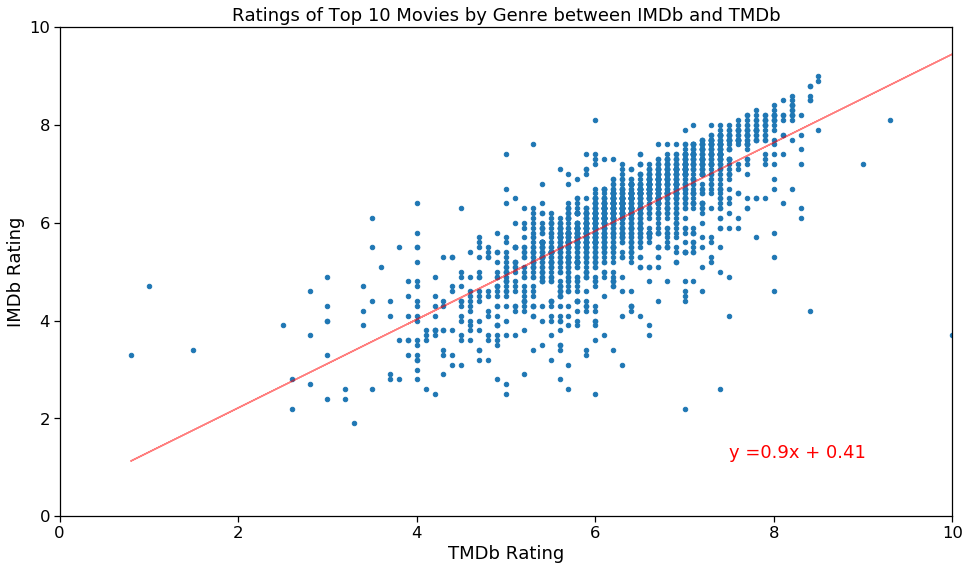

Regression P-value: 0.0
Regression R: 0.7724831498741964


In [131]:
v1_plot = movies.plot(kind = "scatter", x = "tmdb_rating_avg", y = "imdb_rating", figsize=(16,9))
v1_plot.set_title("Ratings of Top 10 Movies by Genre between IMDb and TMDb")
v1_plot.set_xlabel("TMDb Rating")
v1_plot.set_ylabel("IMDb Rating")
v1_plot.set_xlim(0,10)
v1_plot.set_ylim(0,10)

x = movies["tmdb_rating_avg"]
y = movies["imdb_rating"]
m_slope, m_int, m_r, m_p, m_stderr = stats.linregress(x = x,y = y)

regression = m_slope*x + m_int

plt.annotate(f"y ={round(m_slope,2)}x + {round(m_int,2)}", xy = (7.5,1.2), color = "r")

plt.plot(x,regression, color = "r", alpha = 0.5)
plt.show()

print(f"Regression P-value: {m_p}")
print(f"Regression R: {m_r}")

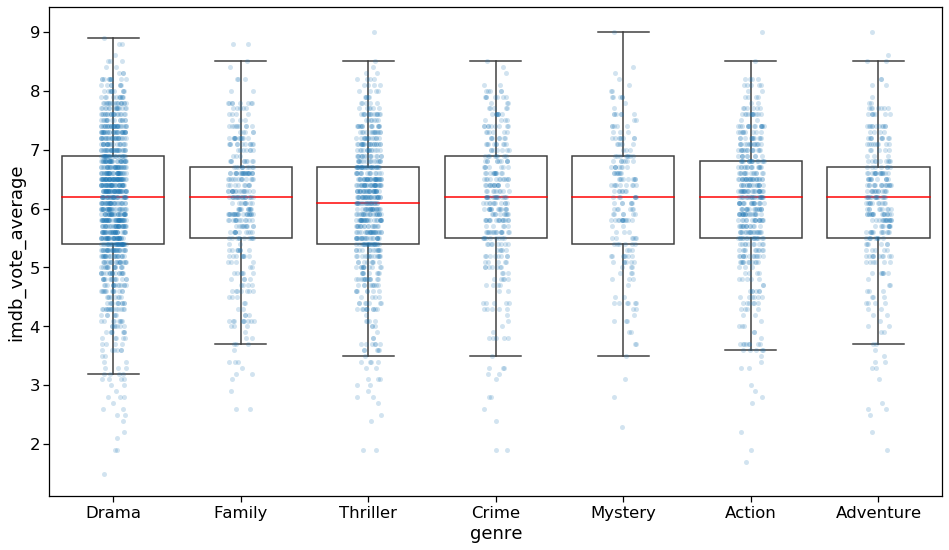

In [132]:


sb.set_context("notebook", font_scale = 1.5)
plt.figure(figsize=(16,9))


sb.stripplot(x = "genre",
y = "imdb_vote_average",
data = genres,
marker = "o",
jitter = True,
dodge = True,
alpha = 0.2)

sb.boxplot(x = "genre",
            y = "imdb_vote_average",
            data = genres,
            boxprops = {"alpha":1, "facecolor":"w"},
            showfliers = False,
            medianprops = {"color":"red"})
            

plt.show()

#### Top 7 Genre Revenue/Budget Analysis

In [2]:
inpath = os.path.join("output","top_movies_by_genre.csv")
inpath2 = os.path.join("output","top_genres.csv")
movies = pd.read_csv(inpath)
genres = pd.read_csv(inpath2)



In [3]:
#   Filter df for movies with budget data
budget_df = genres[['tmdb_id', 'imdb_id', 'budget', 'revenue',
       'tmdb_vote_average','tmdb_vote_count', 'genre', 'startYear', 
       'imdb_vote_average', 'imdb_vote_count']]
budget_df = budget_df.loc[budget_df["budget"]!=0].reset_index()

budget_df

,index,tmdb_id,imdb_id,budget,revenue,tmdb_vote_average,tmdb_vote_count,genre,startYear,imdb_vote_average,imdb_vote_count
0,2,10384,tt0134983,90000000,14828081,4.954,312,Thriller,2000,4.8,18327
1,4,2360,tt0195234,10000000,26330482,6.504,358,Crime,2000,6.9,18715
2,5,4234,tt0134084,40000000,161834276,5.951,2746,Mystery,2000,5.6,145817
3,6,2787,tt0134847,23000000,53187659,6.831,3846,Thriller,2000,7.1,242257
4,7,2787,tt0134847,23000000,53187659,6.831,3846,Action,2000,7.1,242257
...,...,...,...,...,...,...,...,...,...,...,...
1682,3398,624860,tt10838180,190000000,156497322,6.564,4448,Crime,2021,5.7,251721
1683,3399,624860,tt10838180,190000000,156497322,6.564,4448,Drama,2021,5.7,251721
1684,3403,730047,tt12889404,20000000,3000000,6.474,196,Mystery,2021,6.4,11870
1685,3404,730047,tt12889404,20000000,3000000,6.474,196,Thriller,2021,6.4,11870


In [12]:

budget_df["Revenue/Budget"] = budget_df["revenue"]/budget_df["budget"]
budget_df.head(100)

,index,tmdb_id,imdb_id,budget,revenue,tmdb_vote_average,tmdb_vote_count,genre,startYear,imdb_vote_average,imdb_vote_count,Revenue/Budget
0,2,10384,tt0134983,90000000,14828081,4.954,312,Thriller,2000,4.8,18327,0.164756
1,4,2360,tt0195234,10000000,26330482,6.504,358,Crime,2000,6.9,18715,2.633048
2,5,4234,tt0134084,40000000,161834276,5.951,2746,Mystery,2000,5.6,145817,4.045857
3,6,2787,tt0134847,23000000,53187659,6.831,3846,Thriller,2000,7.1,242257,2.312507
4,7,2787,tt0134847,23000000,53187659,6.831,3846,Action,2000,7.1,242257,2.312507
...,...,...,...,...,...,...,...,...,...,...,...,...
95,120,2043,tt0164334,60000000,105178561,6.324,1547,Drama,2001,6.4,88851,1.752976
96,121,10956,tt0245686,17700000,30987695,5.601,628,Drama,2001,5.9,57805,1.750717
97,122,1734,tt0209163,98000000,443280904,6.328,6073,Drama,2001,6.4,328459,4.523275
98,123,1734,tt0209163,98000000,443280904,6.328,6073,Thriller,2001,6.4,328459,4.523275


In [5]:
# sb.FacetGrid(data = budget_df,
#                 row = "genre",
#                 col = "startYear",
#                 sharex = False,
#                 sharey = True)

# plt.show()

In [25]:
budget_df.dtypes

index                  int64
tmdb_id                int64
imdb_id               object
budget                 int64
revenue                int64
tmdb_vote_average    float64
tmdb_vote_count        int64
genre                 object
startYear              int64
imdb_vote_average    float64
imdb_vote_count        int64
Revenue/Budget       float64
dtype: object

ValueError: Could not interpret value `budget` for parameter `x`

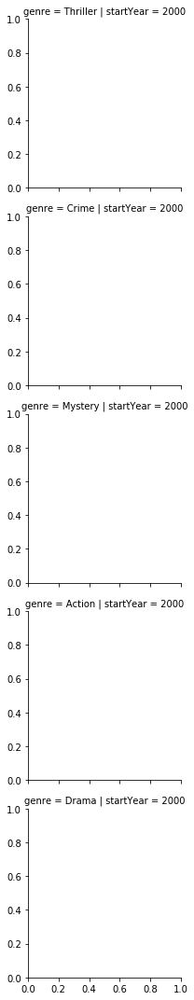

In [24]:
g = sb.FacetGrid(budget_df.head(10),
            row = "genre",
            col = "startYear")

g.map(sb.scatterplot, x = "budget", y = "imdb_vote_average", hue = "genre")

In [53]:
budget_df2 = budget_df.loc[budget_df["startYear"]>2015]
budget_df2.head(2)

,index,tmdb_id,imdb_id,budget,revenue,tmdb_vote_average,tmdb_vote_count,genre,startYear,imdb_vote_average,imdb_vote_count,Revenue/Budget
1270,1832,276905,tt1594972,7000000,17062499,4.664,295,Adventure,2016,3.4,9553,2.4375
1271,1833,276905,tt1594972,7000000,17062499,4.664,295,Family,2016,3.4,9553,2.4375


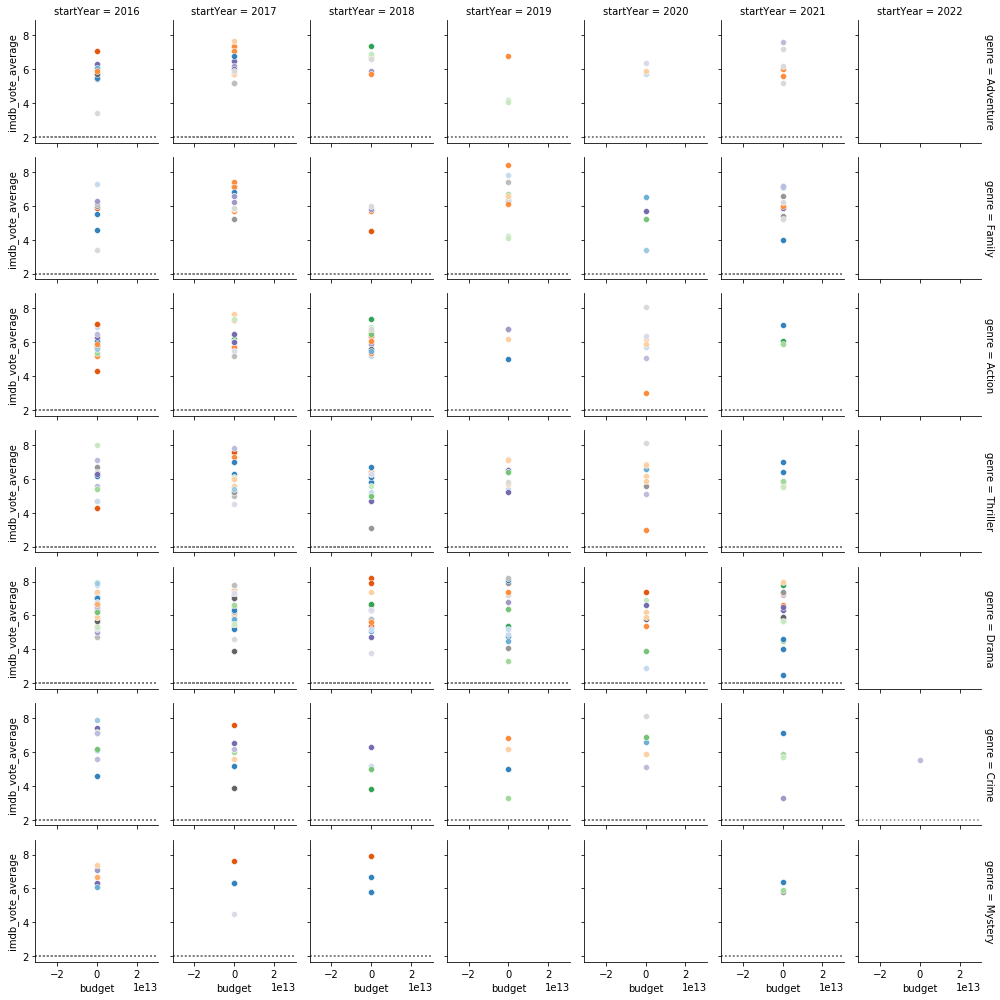

In [56]:
g = sb.FacetGrid(budget_df2,
                row = "genre",
                col = "startYear",
                hue = "budget",
                palette = "tab20c",
                height = 2,
                margin_titles= True)

# g.refline(y = 2, linestyle = ":")

# g.map(plt.plot,"budget", "imdb_vote_average", marker = "o")

g.map(sb.scatterplot, "Revenue/Budget", "imdb_vote_average", marker = "o")

g.set_xlabels("budget")

plt.show()

# Johnny – Data Preparation

In [ ]:
import requests
import pandas as pd
import matplotlib 
import numpy as np
import pprint as pp
import csv

In [ ]:
### Testing output of Discovery/movie url api method
url = "https://api.themoviedb.org/3/discover/movie?api_key=1058f1538710de09e2cc162ffc042010&primary_release_date.gte=2000&with_watch_providers=8|118|21&watch_region=AU&sort_by=primary_release_date.asc&with_original_language=en"

response = requests.get(url).json()
tmdb_df2 = pd.DataFrame(response["results"])
response
# Outdated - since 118 -> 119 (HBO was removed for Amazon Prime)


In [ ]:
# Testing API - individual movies
url = "https://api.themoviedb.org/3/movie/459293"

filter_string = {
    "api_key":"1058f1538710de09e2cc162ffc042010",
    }

movie_response2 = requests.get(url,params=filter_string).json()
movie_response2

In [ ]:
### Cleaning up url with a filter string as params
url = "https://api.themoviedb.org/3/discover/movie?api_key=1058f1538710de09e2cc162ffc042010"
filter_string = {
    "primary_release_date.gte":"2000",
    "with_watch_providers":"8|119|21",
    "watch_region":"AU",
    "sort_by":"primary_release_date.asc",
    "with_original_language":"en"
    }
response = requests.get(url,params=filter_string).json()
tmdb_df = pd.DataFrame(response["results"])
response

In [ ]:
### Save extracted json results into separate lists for later use
url = "https://api.themoviedb.org/3/discover/movie"

adult = []
genre_ids = []
id = []
original_language = []
original_title = []
overview = []
popularity = []
release_date = []
title = []
video = []
vote_average = []
vote_count = []

#(1,501,1)

pages = np.arange(1,373,1) # Updated pages
page = 1
for page in pages:

    filter_string = {
        "api_key":"1058f1538710de09e2cc162ffc042010",
        "primary_release_date.gte":"2000",
        "with_watch_providers":"8|119|21",
        "watch_region":"AU",
        "sort_by":"primary_release_date.asc",
        "with_original_language":"en",
        "page":page

        }
    response = requests.get(url,params=filter_string).json()

    for x in response["results"]:

        adult.append(x["adult"])
        genre_ids.append(x["genre_ids"])
        id.append(x["id"])
        original_language.append(x["original_language"])
        original_title.append(x["original_title"])
        overview.append(x["overview"])
        popularity.append(x["popularity"])
        release_date.append(x["release_date"])
        title.append(x["title"])
        video.append(x["video"])
        vote_average.append(x["vote_average"])
        vote_count.append(x["vote_count"])


In [ ]:
### Acquire service providers as a separate column for final dataframe - requires another API call with /watch/providers method
# Save the resulting results as a dictionary of lists, with id = keys, providers = values (could have more than 1 provider)
### Beware - takes 100 minutes to go through api
movie_providers = {}
name = []

filter_string = {
    "api_key":"1058f1538710de09e2cc162ffc042010",
    }

for ids in id:
    print(f"Checking movie id: {ids}")
    url = "https://api.themoviedb.org/3/movie/" + str(ids) + "/watch/providers"
    print(requests.get(url,params=filter_string))
    provider_response = requests.get(url,params=filter_string).json()
    for item in provider_response["results"]["AU"]["flatrate"]:
        if item["provider_name"] in ["Stan","Netflix","Amazon Prime Video"]:
            name.append(item["provider_name"])
            print(name)
            print(f"Movie ID: {ids} successfully extracted.")
    print(f"Currently on: {ids}")
    movie_providers.update({ids:name})
    name = []

print(movie_providers)

In [ ]:
### Creating a movies provider dataframe -> saving it as csv file
movie_id = list(movie_providers.keys())
provider_df = pd.DataFrame({
    "id":movie_id,
    "providers":list(movie_providers.values())})
provider_df.to_csv("movie_provider.csv",index=False)

In [ ]:
### Acquiring production countries information - BEWARE 100 minute api call
iso_country = []
country_name = []
budget = [] # $ USD I believe
revenue = []
runtime = [] # in minutes

filter_string = {
    "api_key":"1058f1538710de09e2cc162ffc042010",
    }

for i, ids in enumerate(id):
    print(f"Processing movie index {i + 1}, movie ID: {ids}")
    url = "https://api.themoviedb.org/3/movie/" + str(ids)
    print(url)
    print(requests.get(url,params=filter_string))
    movie_response = requests.get(url,params=filter_string).json()
    try: 
        iso_country.append(movie_response["production_countries"][0]["iso_3166_1"])
        country_name.append(movie_response["production_countries"][0]["name"])
        budget.append(movie_response["budget"])
        revenue.append(movie_response["revenue"])
        runtime.append(movie_response["runtime"])
    except Exception:
        iso_country.append("Null")
        country_name.append("Null")
        budget.append("Null")
        revenue.append("Null")
        runtime.append("Null")


In [ ]:
# Output of previous api call into dataframe
country_money_df = pd.DataFrame({
    "id":id,
    "iso_country":iso_country,
    "country_name":country_name,
    "budget":budget,
    "revenue":revenue,
    "runtime":runtime
})

country_money_df.to_csv("country_money.csv",index=False)

In [ ]:
# Creation of main dataframe
movie_df = pd.DataFrame({
    "id":id,
    "original_language":original_language,
    "original_title":original_title,
    "genre_ids":genre_ids,
    "release_date":release_date,
    "video":video,
    "adult":adult,
    "popularity":popularity,
    "vote_average":vote_average,
    "vote_count":vote_count})
movie_df.head()

In [ ]:
### Creating the final csv file
movie_provider_df = pd.read_csv("movie_provider.csv")
first_merge_df = pd.merge(movie_df,movie_provider_df,on="id",how="outer")
cleaned_df = pd.merge(first_merge_df,country_money_df,on="id",how="outer")
cleaned_df.head()

cleaned_df.to_csv("cleaned_movie.csv",index=False)


In [ ]:
### Creating a standardised, clean csv

cleaned_df = pd.read_csv("cleaned_movie.csv")

### Cleaning up brackets in providers column - not sure if necessary - but the code is here
# def cleaning_brackets2(df,column):
#     cleaned_df[column] = cleaned_df[column].apply(lambda x: x.strip('[]').replace("'",''))
#     return cleaned_df
# cleaned_df = cleaning_brackets2(cleaned_df,"providers")

## Merging data from bilal's csv file
# Converting genre id numbers to words
bilal_df = pd.read_csv("tmdb_data_parsed.csv")
cleaned_df = cleaned_df.rename(columns={
    "genre_ids":"genre_id",
    "id":"tmdb_id"})


#Adding in imdb ID - reordering column beside tmdb_id
cleaned_df = pd.merge(cleaned_df,bilal_df[["tmdb_id", "imdb_id"]],on="tmdb_id",how="inner")
cleaned_df = cleaned_df.iloc[:,[0,16,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]]


cleaned_df.count()


In [ ]:
### Grabbing genres from imdb's csv file
imdb_genre_df = pd.read_csv("../../genre.tsv",sep='\t')
imdb_genre_df.head()

In [ ]:
### Preparing genre df for merging
imdb_genre_df = imdb_genre_df.loc[imdb_genre_df["startYear"]!="\\N"]
imdb_genre_df["startYear"] = imdb_genre_df["startYear"].astype(int)
imdb_genre_df = imdb_genre_df.loc[imdb_genre_df["startYear"] > 2000]
imdb_genre_df = imdb_genre_df.drop(["titleType","primaryTitle","originalTitle","isAdult","endYear","runtimeMinutes","startYear"],axis=1)
imdb_genre_df = imdb_genre_df.rename(columns={"tconst":"imdb_id"})
imdb_genre_df.head()
# imdb_genre_df["startYear"].value_counts()

In [ ]:
cleaned_df = pd.merge(cleaned_df,imdb_genre_df,on="imdb_id",how="inner")
cleaned_df.count()
# cleaned_df.to_csv("cleaned_test.csv",index=False)

In [ ]:
## More cleaning up - removing all movies with empty genres -> "null" iso_country (those with null iso_country also have null on subsequent columns)
# cleaned_df = cleaned_df.dropna(how='any')
cleaned_df = cleaned_df.loc[cleaned_df["genres"]!= r"\N"]
print(cleaned_df.count())

# Check if there's any duplicated IDs
print(cleaned_df["tmdb_id"].duplicated().sum())


In [ ]:
### Remove old genre column
cleaned_df = cleaned_df.drop("genre_id",axis=1)
cleaned_df.head()

In [ ]:
### Adding IMDB ratings/vote count into dataset

imdb_rating_df = pd.read_csv("data.tsv",sep='\t') # Code to separate tsv file
imdb_rating_df = imdb_rating_df.rename(columns={"tconst":"imdb_id"})
cleaned_df = pd.merge(cleaned_df,imdb_rating_df,on="imdb_id",how="inner")
cleaned_df = cleaned_df.iloc[:,[0,1,2,3,16,4,5,6,7,8,9,10,17,18,11,12,13,14,15]]
cleaned_df = cleaned_df.rename(columns={
    "averageRating":"imdb_rating",
    "numVotes":"imdb_votes",
    "vote_average":"tmdb_rating_avg",
    "vote_count":"tmdb_vote_count"
})

cleaned_df = cleaned_df.loc[cleaned_df["iso_country"] != "Null"]
print(cleaned_df.count()) # 5360 - with left join from imdb's id (maybe some with no rating scores were removed)
cleaned_df.head()

# cleaned_df.to_csv("cleaned_df2.csv",index=False)

In [ ]:
cleaned_df.to_csv("cleaned_df3.csv",index=False)

In [ ]:
df = pd.read_csv("cleaned_df3.csv")

## Cleaning up brackets in providers column - not sure if necessary - but the code is here
def cleaning_brackets2(df,column):
    df[column] = df[column].apply(lambda x: x.strip('[]').replace("'",''))
    return cleaned_df
df = cleaning_brackets2(cleaned_df,"providers")
df.head()

In [ ]:
### Take provider list, separate them each into a boolean "Yes/no" 
providers_list = cleaned_df["providers"].tolist()
new_list = [item.split(',') for item in providers_list]
new_list = [item.strip() for item in providers_list]
providers = ["Netflix","Stan","Amazon Prime Video"]

provider_boolean = [] # A list of lists, [0] = Netflix, [1] = Stan, [2] = Amazon

for provider in providers:
    provider_presence = []
    for movie in providers_list:
        if provider in movie:
            provider_presence.append("Yes")
        else:
            provider_presence.append("No")
    provider_boolean.append(provider_presence)

print(len(provider_boolean[0]))

In [ ]:
# Creating a dataframe for the booleans - getting ready to merge with the main dataset
provider_boolean_df = pd.DataFrame(provider_boolean[0],columns=["netflix_provider"])
provider_boolean_df = provider_boolean_df.assign(stan_provider=provider_boolean[1])
provider_boolean_df = provider_boolean_df.assign(amazon_provider=provider_boolean[2])
provider_boolean_df = provider_boolean_df.reset_index(level=0,drop=True)
provider_boolean_df.head(10)

In [ ]:
# Given list of lists, resetting index of both dataframes to make sure the merging works
cleaned_df = cleaned_df.reset_index(level=0,drop=True)
provider_boolean_df = provider_boolean_df.reset_index(level=0,drop=True)

In [ ]:
# Merging the two dataframes together 
cleaned_df = pd.concat([cleaned_df,provider_boolean_df],axis=1)
cleaned_df.head()


In [ ]:
cleaned_df.info()

In [ ]:
# Rearranging columns one last time

cleaned_df = cleaned_df.iloc[:,[0,1,2,3,4,5,6,7,8,9,10,11,19,20,21,12,13,14,15,16,17,18]]
cleaned_df.info()

In [ ]:
# Save dataframe as csv
cleaned_df.to_csv("cleaned_df5",index=False)

# Dominique – Data Analysis

In [3]:
#TMDB file
#Set Up Dependencies
import pandas as pd
import requests
import numpy as np
import scipy as sp
import pprint as pp
import datetime
import matplotlib.pyplot as plt
import seaborn as sns


In [4]:
#Open and import csv files

movie_tmdb = pd.read_csv("cleaned_df5.csv")

movie_tmdb

,tmdb_id,imdb_id,original_language,original_title,genres,release_date,video,adult,popularity,tmdb_rating_avg,...,netflix_provider,stan_provider,amazon_provider,imdb_rating,imdb_votes,iso_country,country_name,budget,revenue,runtime
0,134803,tt0221431,en,The Newcomers,"Drama,Family",1/01/2000,False,False,2.339,3.9,...,No,No,Yes,4.8,465,US,United States of America,0,0,90
1,65397,tt0249840,en,Nightfall,"Drama,Sci-Fi,Thriller",1/01/2000,False,False,1.555,3.3,...,No,Yes,No,3.3,463,US,United States of America,0,0,85
2,44388,tt0139388,en,It Had to Be You,"Comedy,Romance",1/01/2000,False,False,9.691,6.2,...,No,No,Yes,5.6,2265,US,United States of America,0,0,90
3,10384,tt0134983,en,Supernova,"Horror,Sci-Fi,Thriller",14/01/2000,False,False,13.377,5.0,...,No,No,Yes,4.8,18336,CH,Switzerland,90000000,14828081,91
4,77434,tt0197096,en,What's Cooking?,"Comedy,Drama,Romance",20/01/2000,False,False,3.519,5.7,...,No,No,Yes,6.8,2811,US,United States of America,0,0,110
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5348,575322,tt5656994,en,Звёздный разум,"Adventure,Sci-Fi,Thriller",6/01/2022,False,False,925.268,5.6,...,No,No,Yes,3.4,3040,CY,Cyprus,0,0,98
5349,825808,tt11209212,en,See for Me,"Crime,Drama,Mystery",7/01/2022,False,False,63.155,6.2,...,Yes,No,No,5.8,5113,CA,Canada,0,0,92
5350,916740,tt13978306,en,Brazen,"Crime,Drama,Mystery",13/01/2022,False,False,61.998,4.9,...,Yes,No,No,4.1,12594,US,United States of America,0,0,94
5351,760926,tt6020800,en,Gold,"Action,Adventure,Thriller",13/01/2022,False,False,70.686,6.3,...,No,Yes,No,5.4,10031,AU,Australia,6500000,176048,97


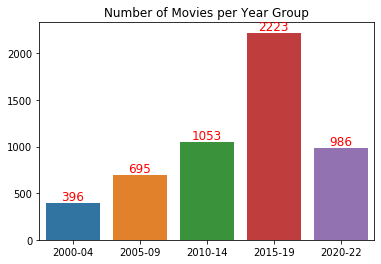

<Figure size 3600x720 with 0 Axes>

In [5]:
movie_tmdb['release_date'].dtype #Initial data type of release dates are in String Object.

movie_tmdb['release_date'] = pd.to_datetime(movie_tmdb['release_date']) #Change to datetime data

#group by the following years: (2000-20004, 2005-2009, 2010-2014, 2015-2019, 2020-2022)

group_one = movie_tmdb[(movie_tmdb['release_date'] >= '2000-01-01') & (movie_tmdb['release_date'] <= '2004-12-31')]
ct_yr1= group_one.count()

group_two =  movie_tmdb[(movie_tmdb['release_date'] >= '2005-01-01') & (movie_tmdb['release_date'] <= '2009-12-31')]
ct_yr2 = group_two.count()

group_three =  movie_tmdb[(movie_tmdb['release_date'] >= '2010-01-01') & (movie_tmdb['release_date'] <= '2014-12-31')]
ct_yr3= group_three.count()

group_four =  movie_tmdb[(movie_tmdb['release_date'] >= '2015-01-01') & (movie_tmdb['release_date'] <= '2019-12-31')]
ct_yr4 = group_four.count()

group_five =  movie_tmdb[(movie_tmdb['release_date'] >= '2020-01-01') & (movie_tmdb['release_date'] <= '2022-12-31')]
ct_yr5 = group_five.count()

total_count = pd.DataFrame({
    "2000": [ct_yr1["original_title"]],
    "2005": [ct_yr2["original_title"]],
    "2010": [ct_yr3["original_title"]],
    "2015": [ct_yr4["original_title"]],
    "2020": [ct_yr5["original_title"]],

})

total_count

## How many movies have been produced in each group?
total_ct = total_count.sum()
Year = ["2000-04", "2005-09", "2010-14", "2015-19" ,"2020-22"]
data = total_count
sns.barplot(x=Year, y=total_ct, data=data).set(title="Number of Movies per Year Group")
ax = plt.gca()
for p in ax.patches:
    ax.text(p.get_x() + p.get_width()/2, p.get_height(), '%d' % int(p.get_height()), fontsize=12, color="red", ha="center", va="bottom")

plt.figure(figsize=(50,10))
plt.show()


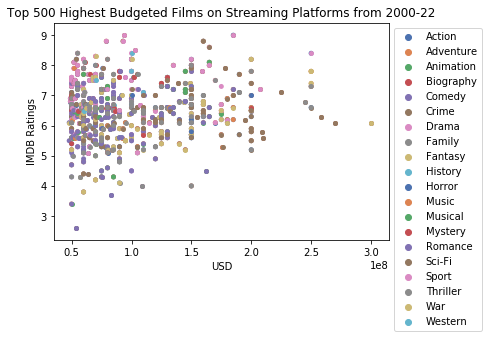

<Figure size 1080x504 with 0 Axes>

In [13]:
# Sort movie dataset according to higest values

highest_budget = movie_tmdb.sort_values(by="budget", ascending=False, ignore_index=True)

highest_budget.drop(highest_budget.index[500:], inplace=True)

#Count the genres by splitting the column

budget_genres = highest_budget.assign(genres=highest_budget.genres.str.split(",")).explode('genres')


#Plot the genre of Top 500 Budgeted Films with according to their IMDB Rating

b1 = sns.stripplot(data=budget_genres.sort_values(by="genres"), y="imdb_rating", x="budget", hue="genres", palette="deep", dodge= True, native_scale=True)
b1.ticklabel_format(style="sci", axis="x")
b1.set(xlabel=None, ylabel=None)
b1.set_title("Top 500 Highest Budgeted Films on Streaming Platforms from 2000-22")
sns.move_legend(b1, "upper left", bbox_to_anchor=(1, 1), title=None )

plt.ylabel("IMDB Ratings")
plt.xlabel("USD")
plt.figure(figsize=(15,7))
plt.tight_layout()

plt.show()

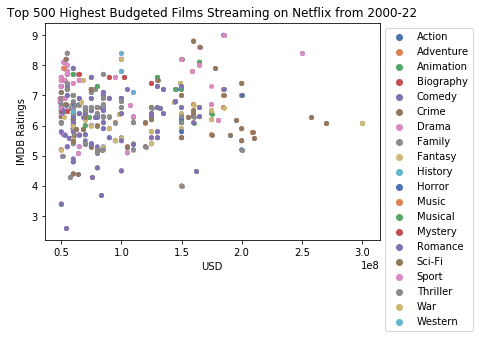

<Figure size 1080x504 with 0 Axes>

In [11]:
# Sort movie dataset according to higest values

highest_budget = movie_tmdb.sort_values(by="budget", ascending=False, ignore_index=True)

highest_budget.drop(highest_budget.index[500:], inplace=True)

#Count the genres by splitting the column

budget_genres = highest_budget.assign(genres=highest_budget.genres.str.split(",")).explode('genres')
budget_genres_netflix = budget_genres[budget_genres['netflix_provider']=='Yes']

#Plot the genre of Top 500 Budgeted Films with according to their IMDB Rating

b1 = sns.stripplot(data=budget_genres_netflix.sort_values(by="genres"), y="imdb_rating", x="budget", hue="genres", palette="deep", dodge= True, native_scale=True)
b1.ticklabel_format(style="sci", axis="x")
b1.set(xlabel=None, ylabel=None)
b1.set_title("Top 500 Highest Budgeted Films Streaming on Netflix from 2000-22")
sns.move_legend(b1, "upper left", bbox_to_anchor=(1, 1), title=None )

plt.ylabel("IMDB Ratings")
plt.xlabel("USD")
plt.figure(figsize=(15,7))
plt.tight_layout()

plt.show()

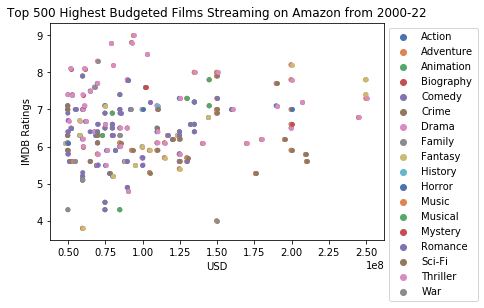

<Figure size 1080x504 with 0 Axes>

In [12]:
# Sort movie dataset according to higest values

highest_budget = movie_tmdb.sort_values(by="budget", ascending=False, ignore_index=True)

highest_budget.drop(highest_budget.index[500:], inplace=True)

#Count the genres by splitting the column

budget_genres = highest_budget.assign(genres=highest_budget.genres.str.split(",")).explode('genres')
budget_genres_amazon = budget_genres[budget_genres['amazon_provider']=='Yes']

#Plot the genre of Top 500 Budgeted Films with according to their IMDB Rating

b1 = sns.stripplot(data=budget_genres_amazon.sort_values(by="genres"), y="imdb_rating", x="budget", hue="genres", palette="deep", dodge= True, native_scale=True)
b1.ticklabel_format(style="sci", axis="x")
b1.set(xlabel=None, ylabel=None)
b1.set_title("Top 500 Highest Budgeted Films Streaming on Amazon from 2000-22")
sns.move_legend(b1, "upper left", bbox_to_anchor=(1, 1), title=None )

plt.ylabel("IMDB Ratings")
plt.xlabel("USD")
plt.figure(figsize=(15,7))
plt.tight_layout()

plt.show()

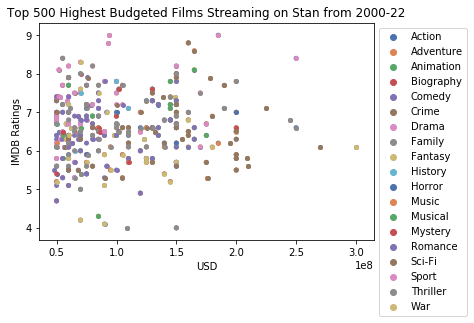

<Figure size 1080x504 with 0 Axes>

In [14]:
# Sort movie dataset according to higest values

highest_budget = movie_tmdb.sort_values(by="budget", ascending=False, ignore_index=True)

highest_budget.drop(highest_budget.index[500:], inplace=True)

#Count the genres by splitting the column

budget_genres = highest_budget.assign(genres=highest_budget.genres.str.split(",")).explode('genres')
budget_genres_stan = budget_genres[budget_genres['stan_provider']=='Yes']

#Plot the genre of Top 500 Budgeted Films with according to their IMDB Rating

b1 = sns.stripplot(data=budget_genres_stan.sort_values(by="genres"), y="imdb_rating", x="budget", hue="genres", palette="deep", dodge= True, native_scale=True)
b1.ticklabel_format(style="sci", axis="x")
b1.set(xlabel=None, ylabel=None)
b1.set_title("Top 500 Highest Budgeted Films Streaming on Stan from 2000-22")
sns.move_legend(b1, "upper left", bbox_to_anchor=(1, 1), title=None )

plt.ylabel("IMDB Ratings")
plt.xlabel("USD")
plt.figure(figsize=(15,7))
plt.tight_layout()

plt.show()

In [18]:
#Separate the genres for easier counts
movie_genre = movie_tmdb.assign(genres=movie_tmdb.genres.str.split(",")).explode('genres')

movie_genre.head()

,tmdb_id,imdb_id,original_language,original_title,genres,release_date,video,adult,popularity,tmdb_rating_avg,...,netflix_provider,stan_provider,amazon_provider,imdb_rating,imdb_votes,iso_country,country_name,budget,revenue,runtime
0,134803,tt0221431,en,The Newcomers,Drama,2000-01-01,False,False,2.339,3.9,...,No,No,Yes,4.8,465,US,United States of America,0,0,90
0,134803,tt0221431,en,The Newcomers,Family,2000-01-01,False,False,2.339,3.9,...,No,No,Yes,4.8,465,US,United States of America,0,0,90
1,65397,tt0249840,en,Nightfall,Drama,2000-01-01,False,False,1.555,3.3,...,No,Yes,No,3.3,463,US,United States of America,0,0,85
1,65397,tt0249840,en,Nightfall,Sci-Fi,2000-01-01,False,False,1.555,3.3,...,No,Yes,No,3.3,463,US,United States of America,0,0,85
1,65397,tt0249840,en,Nightfall,Thriller,2000-01-01,False,False,1.555,3.3,...,No,Yes,No,3.3,463,US,United States of America,0,0,85


In [19]:

#Top 10 highest rated genre per 5 years (2000-20004, 2005-2009, 2010-2014, 2015-2019, 2020-2023)

(movie_genre['release_date'].dtype) #Initial data type of release dates are in String Object.

#Changing release date as datetime datatype for easier extraction of required data
movie_genre['release_date'] = pd.to_datetime(movie_genre['release_date'])

movie_genre #In this df, genre has been separated

#group Genre by the following years: (2000-20004, 2005-2009, 2010-2014, 2015-2019, 2020-2022)

groupyr_one = movie_genre[(movie_genre['release_date'] >= '2000-01-01') & (movie_genre['release_date'] <= '2004-12-31')]
genre_yr1= groupyr_one.count()

groupyr_two =  movie_genre[(movie_genre['release_date'] >= '2005-01-01') & (movie_genre['release_date'] <= '2009-12-31')]
genre_yr2 = groupyr_two.count()

groupyr_three =  movie_genre[(movie_genre['release_date'] >= '2006-01-01') & (movie_genre['release_date'] <= '2014-12-31')]
genre_yr3= groupyr_three.count()

groupyr_four =  movie_genre[(movie_genre['release_date'] >= '2015-01-01') & (movie_genre['release_date'] <= '2019-12-31')]
genre_yr4 = groupyr_four.count()

groupyr_five =  movie_genre[(movie_genre['release_date'] >= '2020-01-01') & (movie_genre['release_date'] <= '2022-12-31')]
genre_yr5 = groupyr_five.count()

genre_count = pd.DataFrame({
    "2000": [genre_yr1["tmdb_id"]],
    "2005": [genre_yr2["tmdb_id"]],
    "2010": [genre_yr3["tmdb_id"]],
    "2015":[genre_yr4["tmdb_id"]],
    "2020":[genre_yr5["tmdb_id"]]
})



In [20]:
#Sort the year groups by highest rating from IMDB and only keep top10

##Group 1: 2000 - 2004
top_imdb_one = groupyr_one.sort_values(by='imdb_rating', ascending=False, ignore_index=True)
top100_yr1 = top_imdb_one.drop(range(100,396))

##Group 2: 2005-2009
top_imdb_two = groupyr_two.sort_values(by='imdb_rating', ascending=False, ignore_index=True)
top100_yr2 = top_imdb_two.drop(range(100,695))

##Group 3: 2010-2014
top_imdb_three = groupyr_three.sort_values(by='imdb_rating', ascending=False, ignore_index=True)
top100_yr3 = top_imdb_three.drop(range(100,1640))

##Group 4: 2015-2019
top_imdb_four = groupyr_four.sort_values(by='imdb_rating', ascending=False, ignore_index=True)
top100_yr4 = top_imdb_four.drop(range(100,2223))

##Group 5: 2020-2022
top_imdb_five = groupyr_five.sort_values(by='imdb_rating', ascending=False, ignore_index=True)
top100_yr5 = top_imdb_five.drop(range(100,986))



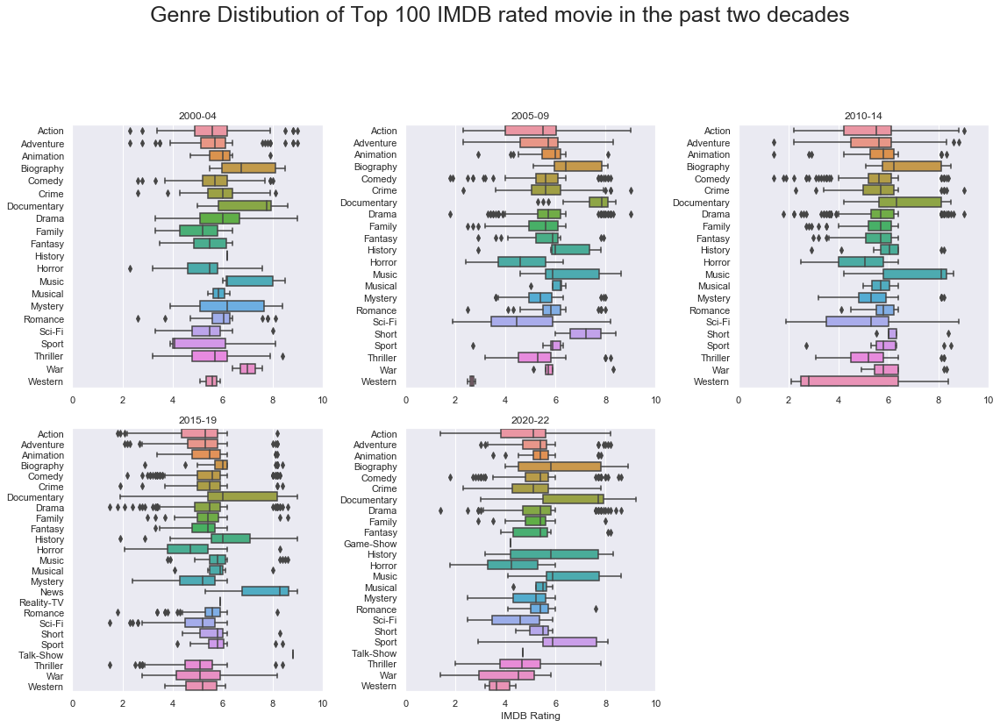

In [21]:
#Category Plots
#Top 100 IMDB films according to Year group
sns.set()

f, axes = plt.subplots(2,3, figsize=(16,10))

sns.boxplot(data=top100_yr1.sort_values(by='genres'), y="genres", x="imdb_rating", ax=axes[0,0]).set(title= "2000-04")
sns.boxplot(data=top100_yr2.sort_values(by='genres'), y="genres", x="imdb_rating", ax=axes[0,1]).set(title= "2005-09")
sns.boxplot(data=top100_yr3.sort_values(by='genres'), y="genres", x="imdb_rating", ax=axes[0,2]).set(title= "2010-14")
sns.boxplot(data=top100_yr4.sort_values(by='genres'), y="genres", x="imdb_rating", ax=axes[1,0]).set(title= "2015-19")
sns.boxplot(data=top100_yr5.sort_values(by='genres'), y="genres", x="imdb_rating", ax=axes[1,1]).set(title= "2020-22")

f.suptitle("Genre Distibution of Top 100 IMDB rated movie in the past two decades", fontsize=25, y=1.15 )

#Remove xlabel="imdb_rating" and ylabel="genres", remove last plot with no data

axes[0,0].set(xlabel=None, ylabel=None,xlim=(0,10))
axes[0,1,].set(xlabel=None, ylabel=None,xlim=(0,10))
axes[0,2].set(xlabel=None, ylabel=None,xlim=(0,10))
axes[1,0].set(xlabel=None, ylabel=None,xlim=(0,10))
axes[1,1].set(xlabel="IMDB Rating", ylabel=None,xlim=(0,10))
axes[1,2].set_visible(False)

plt.tight_layout()

In [22]:
#Netflix Data Only for Genres
netflix = movie_tmdb.query("netflix_provider == 'Yes'")
netflix_clean = netflix.drop(columns= ["stan_provider", "amazon_provider"])

#Stan Data Only
stan = movie_tmdb.query("stan_provider == 'Yes'")
stan_clean = stan.drop(columns= ["netflix_provider", "amazon_provider"])

#Amazon Data only
amazon = movie_tmdb.query("amazon_provider == 'Yes'")
amazon_clean = amazon.drop(columns= ["netflix_provider", "stan_provider"])

In [23]:
#Separate the genres for easier counts
netflix_genre = netflix_clean.assign(genres=netflix_clean.genres.str.split(",")).explode('genres')
stan_genre = stan_clean.assign(genres=stan_clean.genres.str.split(",")).explode('genres')
amazon_genre = amazon_clean.assign(genres=amazon_clean.genres.str.split(",")).explode('genres')


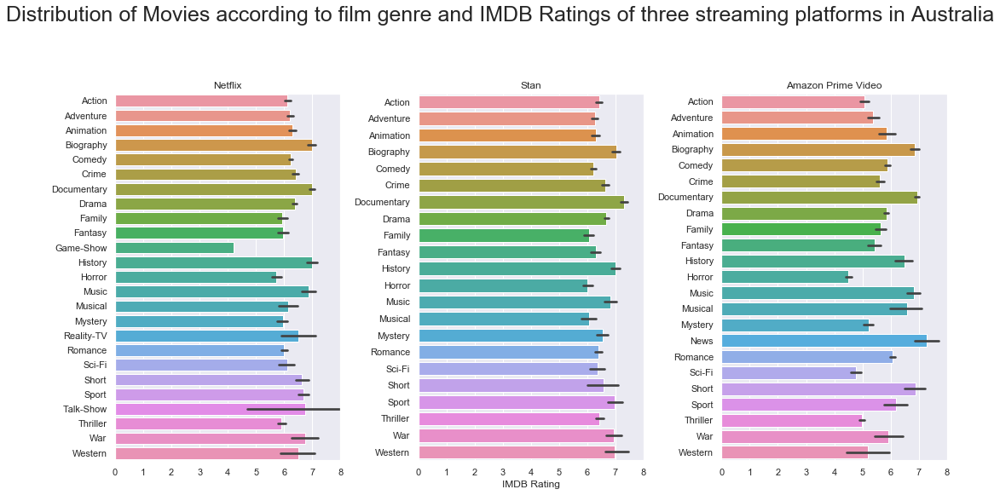

In [24]:
#Compare genre movies from 3 providers

fig, axes = plt.subplots(1,3, figsize=(15, 7))

sns.barplot(data=netflix_genre.sort_values(by='genres'), y="genres", x="imdb_rating", ax=axes[0]).set_title("Netflix")  
sns.barplot(data=stan_genre.sort_values(by='genres'), y="genres", x="imdb_rating", ax=axes[1]).set_title("Stan")
sns.barplot(data=amazon_genre.sort_values(by='genres'), y="genres", x="imdb_rating", ax=axes[2]).set_title("Amazon Prime Video")

fig.suptitle("Distribution of Movies according to film genre and IMDB Ratings of three streaming platforms in Australia", fontsize=25, y=1.15 )

#Remove xlabel="imdb_rating" and ylabel="genres"
axes[0].set(xlabel=None, ylabel=None, xlim=(0,8))
axes[1].set(xlabel="IMDB Rating", ylabel= None,xlim=(0,8))
axes[2].set(xlabel=None, ylabel=None,xlim=(0,8))

plt.tight_layout()
plt.show()

Text(0.5, 0.98, 'Film Runtime and their IMDB Rating across three streaming plaforms')

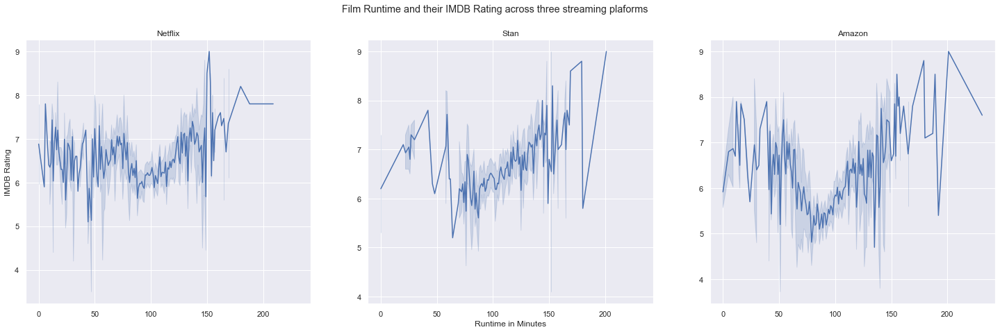

In [25]:
#What are the top 10 movies on Netflix based on IMDB?

#Runtime vs IMDB Rating

# imdb_netflix = netflix_clean.sort_values(by='imdb_rating', ascending=False, ignore_index=True)
fig2, axes= plt.subplots(1,3, figsize=(25, 7), sharex=True)
sns.lineplot(data=netflix_clean, x="runtime", y="imdb_rating", ax=axes[0]).set_title("Netflix")
sns.lineplot(data=stan_clean, x="runtime", y="imdb_rating", ax=axes[1]).set_title("Stan")
sns.lineplot(data=amazon_clean, x="runtime", y="imdb_rating", ax=axes[2]).set_title("Amazon")

axes[0].set(xlabel=None, ylabel="IMDB Rating")
axes[1].set(xlabel="Runtime in Minutes", ylabel=None)
axes[2].set(xlabel=None, ylabel=None)

fig2.suptitle("Film Runtime and their IMDB Rating across three streaming plaforms", fontsize= "large")

# Josh – Data Analysis

In [1]:
import pandas as pd
import json
import requests
import matplotlib.pyplot as plt
import numpy as np
import pprint as pp
import hvplot.pandas
import warnings
import seaborn as sns
warnings.filterwarnings("ignore")

In [2]:
#import csv file
csv = 'cleaned_df5.csv'
df = pd.read_csv(csv)
df[['date','month','year']] = df['release_date'].str.split('/',3, expand = True)
df.head()

,tmdb_id,imdb_id,original_language,original_title,genres,release_date,video,adult,popularity,tmdb_rating_avg,...,imdb_rating,imdb_votes,iso_country,country_name,budget,revenue,runtime,date,month,year
0,134803,tt0221431,en,The Newcomers,"Drama,Family",1/01/2000,False,False,2.339,3.9,...,4.8,465,US,United States of America,0,0,90,1,01,2000
1,65397,tt0249840,en,Nightfall,"Drama,Sci-Fi,Thriller",1/01/2000,False,False,1.555,3.3,...,3.3,463,US,United States of America,0,0,85,1,01,2000
2,44388,tt0139388,en,It Had to Be You,"Comedy,Romance",1/01/2000,False,False,9.691,6.2,...,5.6,2265,US,United States of America,0,0,90,1,01,2000
3,10384,tt0134983,en,Supernova,"Horror,Sci-Fi,Thriller",14/01/2000,False,False,13.377,5.0,...,4.8,18336,CH,Switzerland,90000000,14828081,91,14,01,2000
4,77434,tt0197096,en,What's Cooking?,"Comedy,Drama,Romance",20/01/2000,False,False,3.519,5.7,...,6.8,2811,US,United States of America,0,0,110,20,01,2000


In [3]:
#create dfs for each provider

#netflix
df_netflix = df[df['netflix_provider']=='Yes']
df_netflix_profit = df_netflix[df_netflix['budget']!=0]
df_netflix_profit['profit']=df_netflix_profit['revenue']-df_netflix_profit['budget']
#stan
df_stan = df[df['stan_provider']=='Yes']
df_stan_profit = df_stan[df_stan['budget']!=0]
df_stan_profit['profit']=df_stan_profit['revenue']-df_stan_profit['budget']
#amazon prime
df_amazon = df[df['amazon_provider']=='Yes']
df_amazon_profit = df_amazon[df_amazon['budget']!=0]
df_amazon_profit['profit']=df_amazon_profit['revenue']-df_amazon_profit['budget']


In [4]:
#create Netflix DF
Net_Provider = []
Net_Year = []
Net_Total_Movies = []
Net_Sum_Votes = []
Net_Sum_Scores = []
Net_Average_Votes = []
Net_Average_Score = []
Net_Popularity_Average = []
Net_Popularity_Max = []
Net_Runtime_Average = []
Net_Country_Count = []
Net_Profit = []

list_years = np.arange(2000,2023,1)

for year in list_years:
    df_netflix_year = df_netflix[df_netflix['year']==str(year)]
    Net_Provider.append('Netflix')
    Net_Year.append(year)
    Net_Total_Movies.append(df_netflix_year['original_title'].count())
    Net_Sum_Votes.append(df_netflix_year['imdb_votes'].sum())
    Net_Sum_Scores.append(df_netflix_year['imdb_rating'].sum())
    Net_Average_Votes.append(df_netflix_year['imdb_votes'].sum()/df_netflix_year['original_title'].count())
    Net_Average_Score.append(df_netflix_year['imdb_rating'].sum()/df_netflix_year['original_title'].count())
    Net_Popularity_Average.append(df_netflix_year['popularity'].mean())
    Net_Popularity_Max.append(df_netflix_year['popularity'].max())
    Net_Runtime_Average.append(df_netflix_year['runtime'].mean())
    Net_Country_Count.append(df_netflix_year['country_name'].nunique())

df_netflix_info = pd.DataFrame({
    'Year':Net_Year,
    'Netflix Total Movies':Net_Total_Movies,
    'Netflix Sum Votes':Net_Sum_Votes,
    'Netflix Sum Score':Net_Sum_Scores,
    'Netflix Average Votes':Net_Average_Votes,
    'Netflix Average Score':Net_Average_Score,
    'Netflix Popularity Average':Net_Popularity_Average,
    'Netflix Popularity Max':Net_Popularity_Max,
    'Netflix Runtime Average':Net_Runtime_Average,
    'Netflix No of Countries':Net_Country_Count,
})

df_netflix_info.head()

,Year,Netflix Total Movies,Netflix Sum Votes,Netflix Sum Score,Netflix Average Votes,Netflix Average Score,Netflix Popularity Average,Netflix Popularity Max,Netflix Runtime Average,Netflix No of Countries
0,2000,12,1992801,78.3,166066.750000,6.525000,21.157917,66.943,98.416667,4
1,2001,15,2307553,96.2,153836.866667,6.413333,32.114533,203.183,108.133333,4
2,2002,20,3622839,131.9,181141.950000,6.595000,23.739800,77.935,106.450000,5
3,2003,22,2563307,129.0,116513.954545,5.863636,24.191318,54.913,106.090909,7
4,2004,26,5138339,167.7,197628.423077,6.450000,35.192962,195.958,103.500000,6


In [5]:
#create Stan DF
Stan_Provider = []
Stan_Year = []
Stan_Total_Movies = []
Stan_Sum_Votes = []
Stan_Sum_Scores = []
Stan_Average_Votes = []
Stan_Average_Score = []
Stan_Popularity_Average = []
Stan_Popularity_Max = []
Stan_Runtime_Average = []
Stan_Country_Count = []



list_years = np.arange(2000,2023,1)

for year in list_years:
    df_stan_year = df_stan[df_stan['year']==str(year)]
    Stan_Year.append(year)
    Stan_Total_Movies.append(df_stan_year['original_title'].count())
    Stan_Sum_Votes.append(df_stan_year['imdb_votes'].sum())
    Stan_Sum_Scores.append(df_stan_year['imdb_rating'].sum())
    Stan_Average_Votes.append(df_stan_year['imdb_votes'].sum()/df_stan_year['original_title'].count())
    Stan_Average_Score.append(df_stan_year['imdb_rating'].sum()/df_stan_year['original_title'].count())
    Stan_Popularity_Average.append(df_stan_year['popularity'].mean())
    Stan_Popularity_Max.append(df_stan_year['popularity'].max())
    Stan_Runtime_Average.append(df_stan_year['runtime'].mean())
    Stan_Country_Count.append(df_stan_year['country_name'].nunique())
    
    df_stan_info = pd.DataFrame({
    'Year':Stan_Year,
    'Stan Total Movies':Stan_Total_Movies,
    'Stan Sum Votes':Stan_Sum_Votes,
    'Stan Sum Score':Stan_Sum_Scores,
    'Stan Average Votes':Stan_Average_Votes,
    'Stan Average Score':Stan_Average_Score,
    'Stan Popularity Average':Stan_Popularity_Average,
    'Stan Popularity Max':Stan_Popularity_Max,
    'Stan Runtime Average':Stan_Runtime_Average,
    'Stan No of Countries':Stan_Country_Count
    })

df_stan_info.head()

,Year,Stan Total Movies,Stan Sum Votes,Stan Sum Score,Stan Average Votes,Stan Average Score,Stan Popularity Average,Stan Popularity Max,Stan Runtime Average,Stan No of Countries
0,2000,24,4686865,155.7,195286.041667,6.487500,27.820500,101.626,110.166667,4
1,2001,29,8622879,194.8,297340.655172,6.717241,37.013000,203.183,110.241379,9
2,2002,26,5544515,173.9,213250.576923,6.688462,31.183462,111.370,111.076923,8
3,2003,42,8303595,265.4,197704.642857,6.319048,28.492214,98.166,106.476190,8
4,2004,33,7723589,224.7,234048.151515,6.809091,36.598788,195.958,103.636364,6


In [6]:
#create Amazon DF
Ama_Provider = []
Ama_Year = []
Ama_Total_Movies = []
Ama_Sum_Votes = []
Ama_Sum_Scores = []
Ama_Average_Votes = []
Ama_Average_Score = []
Ama_Popularity_Average = []
Ama_Popularity_Max = []
Ama_Runtime_Average = []
Ama_Country_Count = []

list_years = np.arange(2000,2023,1)

for year in list_years:
    df_amazon_year = df_amazon[df_amazon['year']==str(year)]
    Ama_Provider.append('Amazon')
    Ama_Year.append(year)
    Ama_Total_Movies.append(df_amazon_year['original_title'].count())
    Ama_Sum_Votes.append(df_amazon_year['imdb_votes'].sum())
    Ama_Sum_Scores.append(df_amazon_year['imdb_rating'].sum())
    Ama_Average_Votes.append(df_amazon_year['imdb_votes'].sum()/df_amazon_year['original_title'].count())
    Ama_Average_Score.append(df_amazon_year['imdb_rating'].sum()/df_amazon_year['original_title'].count())
    Ama_Popularity_Average.append(df_amazon_year['popularity'].mean())
    Ama_Popularity_Max.append(df_amazon_year['popularity'].max())
    Ama_Runtime_Average.append(df_amazon_year['runtime'].mean())
    Ama_Country_Count.append(df_amazon_year['country_name'].nunique())

df_amazon_info = pd.DataFrame({
    'Year':Ama_Year,
    'Amazon Total Movies':Ama_Total_Movies,
    'Amazon Sum Votes':Ama_Sum_Votes,
    'Amazon Sum Score':Ama_Sum_Scores,
    'Amazon Average Votes':Ama_Average_Votes,
    'Amazon Average Score':Ama_Average_Score,
    'Amazon Popularity Average':Ama_Popularity_Average,
    'Amazon Popularity Max':Ama_Popularity_Max,
    'Amazon Runtime Average':Ama_Runtime_Average,
    'Amazon No of Countries':Ama_Country_Count
})

df_amazon_info.head()

,Year,Amazon Total Movies,Amazon Sum Votes,Amazon Sum Score,Amazon Average Votes,Amazon Average Score,Amazon Popularity Average,Amazon Popularity Max,Amazon Runtime Average,Amazon No of Countries
0,2000,41,4269215,239.4,104127.195122,5.839024,13.437171,101.626,95.780488,8
1,2001,36,4090954,205.1,113637.611111,5.697222,15.946028,203.183,99.805556,9
2,2002,42,4174314,245.7,99388.428571,5.850000,13.518548,90.732,95.690476,11
3,2003,35,3368140,211.7,96232.571429,6.048571,11.526143,98.166,97.114286,11
4,2004,40,2939228,236.1,73480.700000,5.902500,16.793650,195.958,93.525000,6


In [7]:
#merge df
df_merge1 = df_netflix_info.merge(df_stan_info, on = 'Year')
df_providers_info = df_merge1.merge(df_amazon_info, on = 'Year')
df_providers_info.head()

,Year,Netflix Total Movies,Netflix Sum Votes,Netflix Sum Score,Netflix Average Votes,Netflix Average Score,Netflix Popularity Average,Netflix Popularity Max,Netflix Runtime Average,Netflix No of Countries,...,Stan No of Countries,Amazon Total Movies,Amazon Sum Votes,Amazon Sum Score,Amazon Average Votes,Amazon Average Score,Amazon Popularity Average,Amazon Popularity Max,Amazon Runtime Average,Amazon No of Countries
0,2000,12,1992801,78.3,166066.750000,6.525000,21.157917,66.943,98.416667,4,...,4,41,4269215,239.4,104127.195122,5.839024,13.437171,101.626,95.780488,8
1,2001,15,2307553,96.2,153836.866667,6.413333,32.114533,203.183,108.133333,4,...,9,36,4090954,205.1,113637.611111,5.697222,15.946028,203.183,99.805556,9
2,2002,20,3622839,131.9,181141.950000,6.595000,23.739800,77.935,106.450000,5,...,8,42,4174314,245.7,99388.428571,5.850000,13.518548,90.732,95.690476,11
3,2003,22,2563307,129.0,116513.954545,5.863636,24.191318,54.913,106.090909,7,...,8,35,3368140,211.7,96232.571429,6.048571,11.526143,98.166,97.114286,11
4,2004,26,5138339,167.7,197628.423077,6.450000,35.192962,195.958,103.500000,6,...,6,40,2939228,236.1,73480.700000,5.902500,16.793650,195.958,93.525000,6


In [8]:

#overall netflix summary table
df_netflix_sum = pd.DataFrame({
    "Total Movies":df_netflix['original_title'].count(),
    "Sum Votes":df_netflix['imdb_votes'].sum(),
    "Sum Score":df_netflix['imdb_rating'].sum()
    },index=['Netflix'])
df_netflix_sum['Average Votes'] = df_netflix_sum["Sum Votes"]/df_netflix_sum["Total Movies"]
df_netflix_sum['Average Score'] = df_netflix_sum["Sum Score"]/df_netflix_sum["Total Movies"]

#overall stan summary table
df_stan_sum = pd.DataFrame({
    "Total Movies":df_stan['original_title'].count(),
    "Sum Votes":df_stan['imdb_votes'].sum(),
    "Sum Score":df_stan['imdb_rating'].sum()
    },index=['Stan'])
df_stan_sum['Average Votes'] = df_stan_sum["Sum Votes"]/df_stan_sum["Total Movies"]
df_stan_sum['Average Score'] = df_stan_sum["Sum Score"]/df_stan_sum["Total Movies"]

#overall amazon summary table
df_amazon_sum = pd.DataFrame({
    "Total Movies":df_amazon['original_title'].count(),
    "Sum Votes":df_amazon['imdb_votes'].sum(),
    "Sum Score":df_amazon['imdb_rating'].sum()
    },index=['Amazon'])
df_amazon_sum['Average Votes'] = df_amazon_sum["Sum Votes"]/df_amazon_sum["Total Movies"]
df_amazon_sum['Average Score'] = df_amazon_sum["Sum Score"]/df_amazon_sum["Total Movies"]


#overall dataframe
Providers = ['Netflix','Stan','Amazon Prime']
Total_Movies = [df_netflix_sum.loc['Netflix','Total Movies'],df_stan_sum.loc['Stan','Total Movies'],df_amazon_sum.loc['Amazon','Total Movies']]
Sum_Votes = [df_netflix_sum.loc['Netflix','Sum Votes'],df_stan_sum.loc['Stan','Sum Votes'],df_amazon_sum.loc['Amazon','Sum Votes']]
Sum_Scores = [df_netflix_sum.loc['Netflix','Sum Score'],df_stan_sum.loc['Stan','Sum Score'],df_amazon_sum.loc['Amazon','Sum Score']]
Average_Votes = [df_netflix_sum.loc['Netflix','Average Votes'],df_stan_sum.loc['Stan','Average Votes'],df_amazon_sum.loc['Amazon','Average Votes']]
Average_Scores = [df_netflix_sum.loc['Netflix','Average Score'],df_stan_sum.loc['Stan','Average Score'],df_amazon_sum.loc['Amazon','Average Score']]

sum_all_df = pd.DataFrame({
    'Providers':Providers,
    'Total Movies':Total_Movies,
    'Sum Votes':Sum_Votes,
    'Sum Score':Sum_Scores,
    'Average Votes':Average_Votes,
    'Average Score':Average_Scores
})
sum_all_df.set_index('Providers')

,Total Movies,Sum Votes,Sum Score,Average Votes,Average Score
Providers,,,,,
Netflix,1815,130999063,11501.3,72175.792287,6.336804
Stan,1169,165301357,7599.5,141404.069290,6.500855
Amazon Prime,2761,82488104,15834.1,29876.169504,5.734915


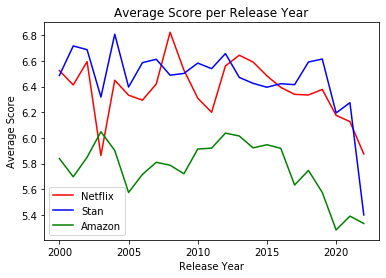

In [9]:
#plot score over year
plt.plot(df_netflix_info['Year'],df_netflix_info['Netflix Average Score'],color = 'red',label = "Netflix")
plt.plot(df_stan_info['Year'],df_stan_info['Stan Average Score'],color = 'blue',label = "Stan")
plt.plot(df_amazon_info['Year'],df_amazon_info['Amazon Average Score'],color = 'green',label = "Amazon")
plt.title("Average Score per Release Year")
plt.xlabel("Release Year")
plt.ylabel("Average Score")
plt.legend()
plt.show()

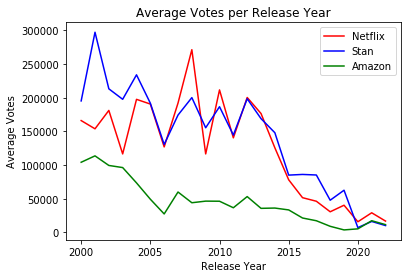

In [10]:
#average vote count over year
plt.plot(df_netflix_info['Year'],df_netflix_info['Netflix Average Votes'],color = 'red',label = "Netflix")
plt.plot(df_stan_info['Year'],df_stan_info['Stan Average Votes'],color = 'blue',label = "Stan")
plt.plot(df_amazon_info['Year'],df_amazon_info['Amazon Average Votes'],color = 'green',label = "Amazon")
plt.title("Average Votes per Release Year")
plt.xlabel("Release Year")
plt.ylabel("Average Votes")
plt.legend()
plt.show()

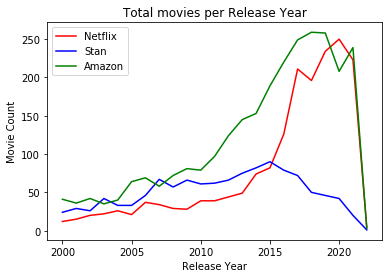

In [11]:
#movie release over year
plt.plot(df_netflix_info['Year'],df_netflix_info['Netflix Total Movies'],color = 'red',label = "Netflix")
plt.plot(df_stan_info['Year'],df_stan_info['Stan Total Movies'],color = 'blue',label = "Stan")
plt.plot(df_amazon_info['Year'],df_amazon_info['Amazon Total Movies'],color = 'green',label = "Amazon")
plt.title("Total movies per Release Year")
plt.xlabel("Release Year")
plt.ylabel("Movie Count")
plt.legend()
plt.show()

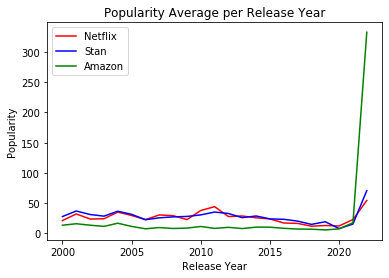

In [12]:
#popularity average over year
plt.plot(df_netflix_info['Year'],df_netflix_info['Netflix Popularity Average'],color = 'red',label = "Netflix")
plt.plot(df_stan_info['Year'],df_stan_info['Stan Popularity Average'],color = 'blue',label = "Stan")
plt.plot(df_amazon_info['Year'],df_amazon_info['Amazon Popularity Average'],color = 'green',label = "Amazon")
plt.title("Popularity Average per Release Year")
plt.xlabel("Release Year")
plt.ylabel("Popularity")
plt.legend()
plt.show()

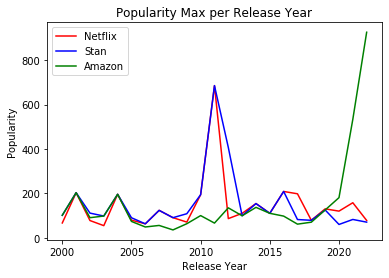

In [13]:
#popularity avg over year
plt.plot(df_netflix_info['Year'],df_netflix_info['Netflix Popularity Max'],color = 'red',label = "Netflix")
plt.plot(df_stan_info['Year'],df_stan_info['Stan Popularity Max'],color = 'blue',label = "Stan")
plt.plot(df_amazon_info['Year'],df_amazon_info['Amazon Popularity Max'],color = 'green',label = "Amazon")
plt.title("Popularity Max per Release Year")
plt.xlabel("Release Year")
plt.ylabel("Popularity")
plt.legend()
plt.show()

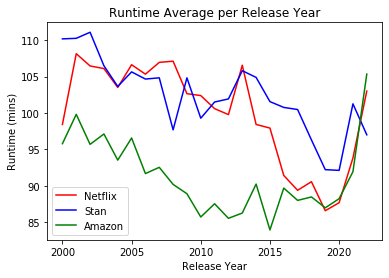

In [14]:
#runtime over year
plt.plot(df_netflix_info['Year'],df_netflix_info['Netflix Runtime Average'],color = 'red',label = "Netflix")
plt.plot(df_stan_info['Year'],df_stan_info['Stan Runtime Average'],color = 'blue',label = "Stan")
plt.plot(df_amazon_info['Year'],df_amazon_info['Amazon Runtime Average'],color = 'green',label = "Amazon")
plt.title("Runtime Average per Release Year")
plt.xlabel("Release Year")
plt.ylabel("Runtime (mins)")
plt.legend()
plt.show()

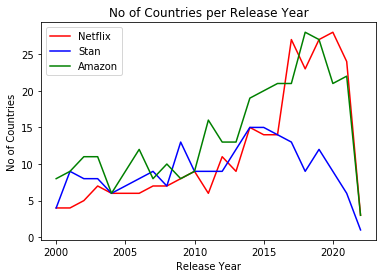

In [15]:
#countries over year
plt.plot(df_netflix_info['Year'],df_netflix_info['Netflix No of Countries'],color = 'red',label = "Netflix")
plt.plot(df_stan_info['Year'],df_stan_info['Stan No of Countries'],color = 'blue',label = "Stan")
plt.plot(df_amazon_info['Year'],df_amazon_info['Amazon No of Countries'],color = 'green',label = "Amazon")
plt.title("No of Countries per Release Year")
plt.xlabel("Release Year")
plt.ylabel("No of Countries")
plt.legend()
plt.show()

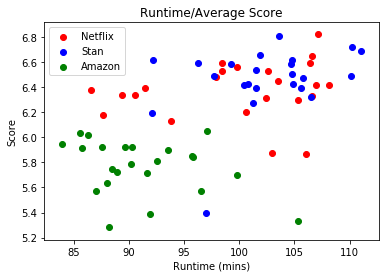

In [16]:
#runtime/average score 
plt.scatter(df_netflix_info['Netflix Runtime Average'],df_netflix_info['Netflix Average Score'],color = 'red',label = "Netflix")
plt.scatter(df_stan_info['Stan Runtime Average'],df_stan_info['Stan Average Score'],color = 'blue',label = "Stan")
plt.scatter(df_amazon_info['Amazon Runtime Average'],df_amazon_info['Amazon Average Score'],color = 'green',label = "Amazon")
plt.title("Runtime/Average Score")
plt.xlabel("Runtime (mins)")
plt.ylabel("Score")
plt.legend()
plt.show()

In [18]:
#netflix country dataframe
Net_Provider = []
Net_Country = []
Net_Total_Movies = []
Net_Sum_Votes = []
Net_Sum_Scores = []
Net_Average_Votes = []
Net_Average_Score = []
Net_Popularity_Average = []
Net_Popularity_Max = []
Net_Runtime_Average = []
Net_Country_Count = []

list_countries = countries = ['United States of America', 'Switzerland', 'Canada', 'France','United Kingdom', 'Australia', 'South Africa', 'Germany', 'Israel','Spain', 'Mexico', 'Ireland', 'Netherlands', 'New Zealand','Jamaica', 'Norway', 'Lithuania', 'Japan', 'Italy', 'Nigeria','Libyan Arab Jamahiriya', 'Hong Kong', 'Czech Republic', 'Finland','India', 'South Korea', 'China', 'Bulgaria', 'Aruba', 'Hungary','Luxembourg', 'Bahamas', 'Austria', 'Poland', 'Romania', 'Iceland','Afghanistan', 'Denmark', 'Kenya', 'United Arab Emirates', 'Iran','Saudi Arabia', 'Somalia', 'Palestinian Territory', 'Philippines','Yemen', 'Turkey', 'Liberia', 'Mali', 'Argentina', 'Belgium','Russia', 'Venezuela', 'Greece', 'Peru', 'Congo', 'Singapore','Brazil', 'Ethiopia', 'Slovakia', 'Morocco', 'Ghana', 'Nepal','Sweden', 'Thailand', 'Chile', 'Cambodia', 'Zimbabwe', 'Colombia','Cuba', 'Lebanon', 'Sierra Leone', 'Indonesia', 'Malaysia','Taiwan', 'Malawi', 'Malta', "Lao People's Democratic Republic",'Pakistan', 'Ukraine', 'Albania', 'Mauritius', 'Ecuador', 'Angola','Cameroon', 'Egypt', 'Cyprus', 'Portugal', 'Tanzania','Puerto Rico']

for country in list_countries:
    df_netflix_country = df_netflix[df_netflix['country_name']==country]
    try:
        Net_Provider.append('Netflix')
        Net_Country.append(country)
        Net_Total_Movies.append(df_netflix_country['original_title'].count())
        Net_Sum_Votes.append(df_netflix_country['imdb_votes'].sum())
        Net_Sum_Scores.append(df_netflix_country['imdb_rating'].sum())
        Net_Average_Votes.append(df_netflix_country['imdb_votes'].sum()/df_netflix_country['original_title'].count())
        Net_Average_Score.append(df_netflix_country['imdb_rating'].sum()/df_netflix_country['original_title'].count())
        Net_Popularity_Average.append(df_netflix_country['popularity'].mean())
        Net_Popularity_Max.append(df_netflix_country['popularity'].max())
        Net_Runtime_Average.append(df_netflix_country['runtime'].mean())   

    except:
       pass

df_netflix_country_info = pd.DataFrame({
    'Country':Net_Country,
    'Netflix Total Movies':Net_Total_Movies,
    'Netflix Sum Votes':Net_Sum_Votes,
    'Netflix Sum Score':Net_Sum_Scores,
    'Netflix Average Votes':Net_Average_Votes,
    'Netflix Average Score':Net_Average_Score,
    'Netflix Popularity Average':Net_Popularity_Average,
    'Netflix Popularity Max':Net_Popularity_Max,
    'Netflix Runtime Average':Net_Runtime_Average,

})

df_netflix_country_info.reset_index()

lat = []
lon = []

nf_country = df_netflix_country_info['Country'].tolist()

for x in nf_country:
    try:
        params = {
            'country':f'{x}'
        }
        url='https://api.geoapify.com/v1/geocode/search?&apiKey=f619430c76c7485aaeccc2fc5da48b08'

        response = requests.get(url,params=params).json()
        lon.append(response["features"][0]["properties"]["lon"])
        lat.append(response["features"][0]["properties"]["lat"])
    
    except:
        lon.append('NA')
        lat.append('NA')

df_netflix_country_info['Netflix Lat'] = lat
df_netflix_country_info['Netflix Lon'] = lon

df_netflix_country_info.dropna()

df_netflix_country_info.head()

,Country,Netflix Total Movies,Netflix Sum Votes,Netflix Sum Score,Netflix Average Votes,Netflix Average Score,Netflix Popularity Average,Netflix Popularity Max,Netflix Runtime Average,Netflix Lat,Netflix Lon
0,United States of America,1145,89621811,7248.2,78272.324017,6.330306,21.831550,685.121,92.138865,39.7837,-100.446
1,Switzerland,1,168,7.3,168.000000,7.300000,1.350000,1.350,25.000000,46.7986,8.23197
2,Canada,118,7079861,726.3,59998.822034,6.155085,21.603051,129.650,93.313559,61.0667,-107.992
3,France,24,4356684,167.2,181528.500000,6.966667,23.536375,54.205,102.750000,46.6034,1.88833
4,United Kingdom,112,14536478,741.5,129789.982143,6.620536,19.194527,154.271,91.464286,54.7024,-3.27658


In [19]:
#stan country dataframe
Stan_Provider = []
Stan_Country = []
Stan_Total_Movies = []
Stan_Sum_Votes = []
Stan_Sum_Scores = []
Stan_Average_Votes = []
Stan_Average_Score = []
Stan_Popularity_Average = []
Stan_Popularity_Max = []
Stan_Runtime_Average = []
Stan_Country_Count = []

list_countries = countries = ['United States of America', 'Switzerland', 'Canada', 'France','United Kingdom', 'Australia', 'South Africa', 'Germany', 'Israel','Spain', 'Mexico', 'Ireland', 'Netherlands', 'New Zealand','Jamaica', 'Norway', 'Lithuania', 'Japan', 'Italy', 'Nigeria','Libyan Arab Jamahiriya', 'Hong Kong', 'Czech Republic', 'Finland','India', 'South Korea', 'China', 'Bulgaria', 'Aruba', 'Hungary','Luxembourg', 'Bahamas', 'Austria', 'Poland', 'Romania', 'Iceland','Afghanistan', 'Denmark', 'Kenya', 'United Arab Emirates', 'Iran','Saudi Arabia', 'Somalia', 'Palestinian Territory', 'Philippines','Yemen', 'Turkey', 'Liberia', 'Mali', 'Argentina', 'Belgium','Russia', 'Venezuela', 'Greece', 'Peru', 'Congo', 'Singapore','Brazil', 'Ethiopia', 'Slovakia', 'Morocco', 'Ghana', 'Nepal','Sweden', 'Thailand', 'Chile', 'Cambodia', 'Zimbabwe', 'Colombia','Cuba', 'Lebanon', 'Sierra Leone', 'Indonesia', 'Malaysia','Taiwan', 'Malawi', 'Malta', "Lao People's Democratic Republic",'Pakistan', 'Ukraine', 'Albania', 'Mauritius', 'Ecuador', 'Angola','Cameroon', 'Egypt', 'Cyprus', 'Portugal', 'Tanzania','Puerto Rico']

for country in list_countries:
    df_stan_country = df_stan[df_stan['country_name']==country]
    try:
        Stan_Provider.append('Stan')
        Stan_Country.append(country)
        Stan_Total_Movies.append(df_stan_country['original_title'].count())
        Stan_Sum_Votes.append(df_stan_country['imdb_votes'].sum())
        Stan_Sum_Scores.append(df_stan_country['imdb_rating'].sum())
        Stan_Average_Votes.append(df_stan_country['imdb_votes'].sum()/df_stan_country['original_title'].count())
        Stan_Average_Score.append(df_stan_country['imdb_rating'].sum()/df_stan_country['original_title'].count())
        Stan_Popularity_Average.append(df_stan_country['popularity'].mean())
        Stan_Popularity_Max.append(df_stan_country['popularity'].max())
        Stan_Runtime_Average.append(df_stan_country['runtime'].mean())

    except:
       pass

df_stan_country_info = pd.DataFrame({
    'Country':Stan_Country,
    'Stan Total Movies':Stan_Total_Movies,
    'Stan Sum Votes':Stan_Sum_Votes,
    'Stan Sum Score':Stan_Sum_Scores,
    'Stan Average Votes':Stan_Average_Votes,
    'Stan Average Score':Stan_Average_Score,
    'Stan Popularity Average':Stan_Popularity_Average,
    'Stan Popularity Max':Stan_Popularity_Max,
    'Stan Runtime Average':Stan_Runtime_Average,

})

df_stan_country_info.reset_index()

lat = []
lon = []

st_country = df_stan_country_info['Country'].tolist()

for x in st_country:
    try:
        params = {
            'country':f'{x}'
        }
        url='https://api.geoapify.com/v1/geocode/search?&apiKey=f619430c76c7485aaeccc2fc5da48b08'

        response = requests.get(url,params=params).json()
        lon.append(response["features"][0]["properties"]["lon"])
        lat.append(response["features"][0]["properties"]["lat"])
    
    except:
        lon.append('NA')
        lat.append('NA')
        
df_stan_country_info['Stan Lat'] = lat
df_stan_country_info['Stan Lon'] = lon

df_stan_country_info.dropna()

df_stan_country_info.head()

,Country,Stan Total Movies,Stan Sum Votes,Stan Sum Score,Stan Average Votes,Stan Average Score,Stan Popularity Average,Stan Popularity Max,Stan Runtime Average,Stan Lat,Stan Lon
0,United States of America,613,99704291,3927.4,162649.740620,6.406852,31.012276,685.121,103.367047,39.7837,-100.446
1,Switzerland,2,137664,11.7,68832.000000,5.850000,26.735500,31.918,95.500000,46.7986,8.23197
2,Canada,69,8337972,441.1,120840.173913,6.392754,30.642174,95.857,101.159420,61.0667,-107.992
3,France,43,7480816,291.5,173972.465116,6.779070,21.563465,62.857,109.418605,46.6034,1.88833
4,United Kingdom,166,22442567,1145.9,135196.186747,6.903012,17.241241,154.271,93.518072,54.7024,-3.27658


In [20]:
#amazon country dataframe
Ama_Provider = []
Ama_Country = []
Ama_Total_Movies = []
Ama_Sum_Votes = []
Ama_Sum_Scores = []
Ama_Average_Votes = []
Ama_Average_Score = []
Ama_Popularity_Average = []
Ama_Popularity_Max = []
Ama_Runtime_Average = []
Ama_Country_Count = []

list_countries = countries = ['United States of America', 'Switzerland', 'Canada', 'France','United Kingdom', 'Australia', 'South Africa', 'Germany', 'Israel','Spain', 'Mexico', 'Ireland', 'Netherlands', 'New Zealand','Jamaica', 'Norway', 'Lithuania', 'Japan', 'Italy', 'Nigeria','Libyan Arab Jamahiriya', 'Hong Kong', 'Czech Republic', 'Finland','India', 'South Korea', 'China', 'Bulgaria', 'Aruba', 'Hungary','Luxembourg', 'Bahamas', 'Austria', 'Poland', 'Romania', 'Iceland','Afghanistan', 'Denmark', 'Kenya', 'United Arab Emirates', 'Iran','Saudi Arabia', 'Somalia', 'Palestinian Territory', 'Philippines','Yemen', 'Turkey', 'Liberia', 'Mali', 'Argentina', 'Belgium','Russia', 'Venezuela', 'Greece', 'Peru', 'Congo', 'Singapore','Brazil', 'Ethiopia', 'Slovakia', 'Morocco', 'Ghana', 'Nepal','Sweden', 'Thailand', 'Chile', 'Cambodia', 'Zimbabwe', 'Colombia','Cuba', 'Lebanon', 'Sierra Leone', 'Indonesia', 'Malaysia','Taiwan', 'Malawi', 'Malta', "Lao People's Democratic Republic",'Pakistan', 'Ukraine', 'Albania', 'Mauritius', 'Ecuador', 'Angola','Cameroon', 'Egypt', 'Cyprus', 'Portugal', 'Tanzania','Puerto Rico']

for country in list_countries:
    df_amazon_country = df_amazon[df_amazon['country_name']==country]
    try:
        Ama_Provider.append('Amazon')
        Ama_Country.append(country)
        Ama_Total_Movies.append(df_amazon_country['original_title'].count())
        Ama_Sum_Votes.append(df_amazon_country['imdb_votes'].sum())
        Ama_Sum_Scores.append(df_amazon_country['imdb_rating'].sum())
        Ama_Average_Votes.append(df_amazon_country['imdb_votes'].sum()/df_amazon_country['original_title'].count())
        Ama_Average_Score.append(df_amazon_country['imdb_rating'].sum()/df_amazon_country['original_title'].count())
        Ama_Popularity_Average.append(df_amazon_country['popularity'].mean())
        Ama_Popularity_Max.append(df_amazon_country['popularity'].max())
        Ama_Runtime_Average.append(df_amazon_country['runtime'].mean())

    except:
       pass

df_amazon_country_info = pd.DataFrame({
    'Country':Ama_Country,
    'Amazon Total Movies':Ama_Total_Movies,
    'Amazon Sum Votes':Ama_Sum_Votes,
    'Amazon Sum Score':Ama_Sum_Scores,
    'Amazon Average Votes':Ama_Average_Votes,
    'Amazon Average Score':Ama_Average_Score,
    'Amazon Popularity Average':Ama_Popularity_Average,
    'Amazon Popularity Max':Ama_Popularity_Max,
    'Amazon Runtime Average':Ama_Runtime_Average,

})

df_amazon_country_info.reset_index()

lat = []
lon = []

az_country = df_amazon_country_info['Country'].tolist()

for x in az_country:
    try:
        params = {
                'country':f'{x}'
            }
        url='https://api.geoapify.com/v1/geocode/search?&apiKey=f619430c76c7485aaeccc2fc5da48b08'

        response = requests.get(url,params=params).json()
        lon.append(response["features"][0]["properties"]["lon"])
        lat.append(response["features"][0]["properties"]["lat"])

       
    except:
        lon.append('NA')
        lat.append('NA')

df_amazon_country_info['Amazon Lat'] = lat
df_amazon_country_info['Amazon Lon'] = lon

df_amazon_country_info.dropna()

df_amazon_country_info.head()


,Country,Amazon Total Movies,Amazon Sum Votes,Amazon Sum Score,Amazon Average Votes,Amazon Average Score,Amazon Popularity Average,Amazon Popularity Max,Amazon Runtime Average,Amazon Lat,Amazon Lon
0,United States of America,1548,47969998,8690.9,30988.370801,5.614276,10.261784,533.475,88.620155,39.7837,-100.446
1,Switzerland,4,21803,21.8,5450.750000,5.450000,4.913000,13.377,93.750000,46.7986,8.23197
2,Canada,434,5785116,2495.3,13329.760369,5.749539,7.597691,132.652,87.394009,61.0667,-107.992
3,France,31,2587130,197.2,83455.806452,6.361290,18.924290,118.403,98.709677,46.6034,1.88833
4,United Kingdom,272,6187099,1589.5,22746.687500,5.843750,7.507625,102.745,86.852941,54.7024,-3.27658


In [ ]:
df_merge1 = df_netflix_country_info.merge(df_stan_country_info, on = 'Country')
df_providers_country_info = df_merge1.merge(df_amazon_country_info, on = 'Country')
df_providers_country_info.head()

In [ ]:
netflix_map = df_netflix_country_info[df_netflix_country_info['Netflix Lon']!='NA'].hvplot.points(
   "Netflix Lon",
    "Netflix Lat",
    geo = True,
    tiles = "EsriImagery",
    frame_width = 800,
    frame_height = 600,
    size = "Netflix Total Movies",
    scale = 2,
    c = "Netflix Average Score",
    cmap='Reds',
    clim=(5,9),
   xlabel = 'Latitude',
    ylabel = 'Longitude',
    size_fn=lambda x: x+1,
    alpha=1,
    clabel = 'Average Score',   
    title = "Netflix - Country of Origin vs Quality",
   )


netflix_map

In [ ]:
stan_map = df_stan_country_info[df_stan_country_info['Stan Lon']!='NA'].hvplot.points(
    "Stan Lon",
    "Stan Lat",
    geo = True,
    tiles = "EsriImagery",
    frame_width = 800,
    frame_height = 600,
    xlabel = 'Latitude',
    ylabel = 'Longitude',
    size = "Stan Total Movies",
    scale = 2,
    c = "Stan Average Score",
    cmap='Blues',
    clim=(5,9),
    clabel = 'Average Score',
    size_fn=lambda x: x+1,
    alpha=1,
    title = "Stan - Country of Origin vs Quality")

stan_map

In [ ]:
amazon_map = df_amazon_country_info[df_amazon_country_info['Amazon Lon']!='NA'].hvplot.points(
    "Amazon Lon",
    "Amazon Lat",
    geo = True,
    tiles = "EsriImagery",
    frame_width = 800,
    frame_height = 600,
    size = "Amazon Total Movies",
    scale = 2,
    c = "Amazon Average Score",
    cmap='Greens',
    clim=(5,9),
    size_fn=lambda x: x+1,
    alpha=1,
    xlabel = 'Latitude',
    ylabel = 'Longitude',
    clabel = 'Average Score',
    title = "Amazon - Country of Origin vs Quality")

amazon_map

In [ ]:
Net_Year = []
Net_Total_Movies = []
Net_Profit = []


list_years = np.arange(2000,2023,1)

for year in list_years:
    df_netflix_profit_year = df_netflix_profit[df_netflix_profit['year']==str(year)]
    Net_Year.append(year)
    Net_Total_Movies.append(df_netflix_profit_year['original_title'].count())
    Net_Profit.append(df_netflix_profit_year['profit'].sum())

df_netflix_profit_info = pd.DataFrame({
    'Year':Net_Year,
    'Netflix Total Movies':Net_Total_Movies,
    'Netflix Profit':Net_Profit
})

df_netflix_profit_info


In [ ]:
Stan_Year = []
Stan_Total_Movies = []
Stan_Profit = []


list_years = np.arange(2000,2023,1)

for year in list_years:
    df_stan_profit_year = df_stan_profit[df_stan_profit['year']==str(year)]
    Stan_Year.append(year)
    Stan_Total_Movies.append(df_stan_profit_year['original_title'].count())
    Stan_Profit.append(df_stan_profit_year['profit'].sum())

df_stan_profit_info = pd.DataFrame({
    'Year':Stan_Year,
    'Stan Total Movies':Stan_Total_Movies,
    'Stan Profit':Stan_Profit
})

df_stan_profit_info.head()

In [ ]:
Ama_Year = []
Ama_Total_Movies = []
Ama_Profit = []


list_years = np.arange(2000,2023,1)

for year in list_years:
    df_amazon_profit_year = df_amazon_profit[df_amazon_profit['year']==str(year)]
    Ama_Year.append(year)
    Ama_Total_Movies.append(df_amazon_profit_year['original_title'].count())
    Ama_Profit.append(df_amazon_profit_year['profit'].sum())

df_amazon_profit_info = pd.DataFrame({
    'Year':Ama_Year,
    'Amazon Total Movies':Ama_Total_Movies,
    'Amazon Profit':Ama_Profit
})

df_amazon_profit_info.head()

In [ ]:
plt.plot(df_netflix_profit_info['Year'],df_netflix_profit_info['Netflix Profit'],color='red',label='Netflix')
plt.plot(df_stan_profit_info['Year'],df_stan_profit_info['Stan Profit'],color='blue',label='Stan')
plt.plot(df_amazon_profit_info['Year'],df_amazon_profit_info['Amazon Profit'],color='green',label='Amazon')
plt.title("Average Profit of Films on Platform over Years")
plt.xlabel("Year")
plt.legend()
plt.axhline(y=df_netflix_profit_info['Netflix Profit'].mean(), color = 'red', linestyle = '--')
plt.axhline(y=df_stan_profit_info['Stan Profit'].mean(), color = 'blue', linestyle = '--')
plt.axhline(y=df_amazon_profit_info['Amazon Profit'].mean(), color = 'green', linestyle = '--')
plt.ylabel("Profit")